<a href="https://colab.research.google.com/github/Sam122300/Audio-Classification-using-Deep-Learning/blob/master/FYP_HoeLunSam.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Import Necessary Libraries, Packages and Data**

In [ ]:
# Install statsmodels (for feature engineering) and keras tuner (for hyperparameter tuning)
!pip install -i https://pypi.anaconda.org/scipy-wheels-nightly/simple statsmodels==0.14.0.dev674
!pip install keras-tuner -q

# Import all the necessary libraries
import numpy as np
import pandas as pd
import math
import random

# Feature Engineering
import seaborn as sns # for Pearson correlation coefficient analysis
import statsmodels.api as sm
import statsmodels
from statsmodels.tsa.seasonal import MSTL # for time series decomposition
from statsmodels.graphics.tsaplots import plot_acf # for autocorrelation analysis
from statsmodels.tsa.stattools import acf
from scipy.signal import find_peaks

# Model Training
import tensorflow as tf
from tensorflow import keras # for building Neural Networks
from keras.models import Sequential # for creating a linear stack of layers for our Neural Network
from keras.optimizers import RMSprop, SGD, Adam
from keras import Input # for instantiating a keras tensor
from keras.layers import Bidirectional, GRU, Dense, LSTM, Dropout, SimpleRNN # for creating layers inside the Neural Network
from keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard, ReduceLROnPlateau
# from keras.backend import square, mean
import keras_tuner

# Model Evaluation
import sklearn
# from sklearn.preprocessing import MinMaxScaler # for feature scaling
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score


# Visualization
# import plotly
# import plotly.express as px
# import plotly.graph_objects as go
# print('plotly: %s' % plotly.__version__) # print version
import matplotlib.pyplot as plt

# Mount drive
from google.colab import drive
drive.mount('/content/drive')

Looking in indexes: https://pypi.anaconda.org/scipy-wheels-nightly/simple
plotly: 5.13.1
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Import data
csv_path ='/content/drive/MyDrive/FYP/M3a_ACS_MOM_ERR_1_7Apr21_to7Apr22.csv'
csv_path_2 ='/content/drive/MyDrive/FYP/ACS_MOM_ERR_1_7Apr20_to7Apr21.csv'
csv_path_y = '/content/drive/MyDrive/FYP/M3a_ACS_MOM_ERR_2_7Apr21_to7Apr22.csv'
csv_path_y2 = '/content/drive/MyDrive/FYP/ACS_MOM_ERR_2_7Apr20_to7Apr21.csv'
csv_path_z = '/content/drive/MyDrive/FYP/M3a_ACS_MOM_ERR_3_7Apr21_to7Apr22.csv'
csv_path_z2 = '/content/drive/MyDrive/FYP/ACS_MOM_ERR_3_7Apr20_to7Apr21.csv'
maneuver_path = '/content/drive/MyDrive/FYP/OO_Measat_maneuver_start_end_20220712.csv'



# **Data** **Exploration**

READ DATA, RESAMPLING AND FILLING MISSING VALUE

0                   NaT
1       0 days 00:08:08
2       0 days 00:08:16
3       0 days 00:08:12
4       0 days 00:08:24
              ...      
35310   0 days 00:13:44
35311   0 days 00:13:48
35312   0 days 00:14:04
35313   0 days 00:13:56
35314   0 days 00:00:16
Name: DateTime, Length: 35315, dtype: timedelta64[ns]
There are nulls.


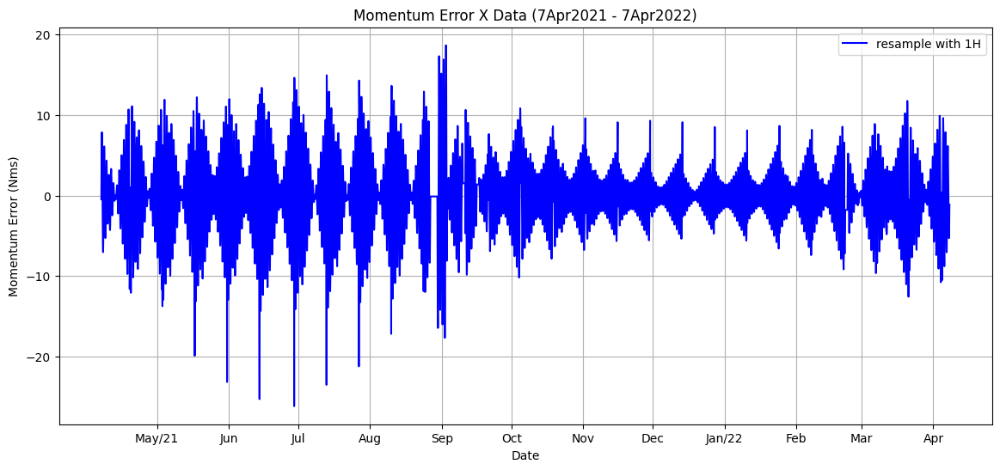

YValue    18.66418
Name: 2021-09-02 17:00:00, dtype: float64
YValue   -26.16079
Name: 2021-06-29 05:00:00, dtype: float64
-0.06475424730339255
4.496665221415184


In [ ]:
df = pd.read_csv(csv_path, skiprows=4) #skip the first 3 rows in the csv file
df.drop('mSec', inplace=True, axis=1) #Will look into the possibility of including the mSec feature
date_time = pd.to_datetime(df.pop('DateTime'), format='%Y-%m-%d %H:%M:%S') #change the DateTime data to Pandas datetime format
df['DateTime'] = date_time #Replace the DateTime column
print(df['DateTime'].diff())
df.set_index('DateTime', inplace=True) #Set the DateTime column as index
# print(df.head(5))
# df1 = df.resample("10min").first() #Resample the data by taking the first data of every 1-hour interval
# print(df.head(5))
df = df.resample("1H").first()

if df.isnull().values.any():
   print('There are nulls.')
   df = df.fillna(method='ffill')

fig = plt.figure(figsize=(14,6)) #Plot the data
# plt.plot(df1[96:109], color='blue', label='resample with 10mins')
plt.plot(df, color='blue', label='resample with 1H')
# plt.plot(df[78:85], color='green', label='original data')
plt.title('Momentum Error X Data (7Apr2021 - 7Apr2022)')
plt.xlabel('Date')
plt.ylabel('Momentum Error (Nms)')
plt.legend()
x_ticks_index = []
for value in df.index[0:len(df):24]:
   if value.is_month_start == True:
    x_ticks_index.append(df.index.get_loc(value))
x_ticks_index = np.array(x_ticks_index)
plt.xticks(df.index[x_ticks_index], labels=['May/21','Jun','Jul','Aug', 'Sep', 'Oct', 'Nov', 'Dec', 'Jan/22','Feb','Mar','Apr'])
plt.grid(True)
plt.show()
print(df.loc[df['YValue'].idxmax()])
print(df.loc[df['YValue'].idxmin()])
print(df['YValue'].mean())
print(df['YValue'].std())

There are null


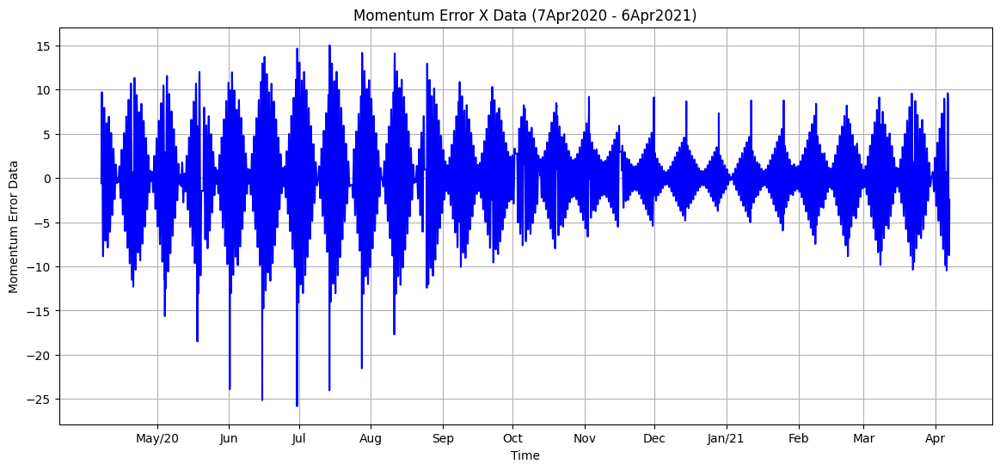

YValue    15.0069
Name: 2020-07-14 06:00:00, dtype: float64
YValue   -25.81792
Name: 2020-06-30 05:00:00, dtype: float64
-0.05163411305479452
4.329019813892754


In [ ]:
test_df = pd.read_csv(csv_path_2, skiprows=3) #skip the first 3 rows in the csv file
test_df.drop('mSec', inplace=True, axis=1) #Will look into the possibility of including the mSec feature
date_time = pd.to_datetime(test_df.pop('DateTime'), format='%d-%m-%y %H:%M') #change the DateTime data to Pandas datetime format
test_df['DateTime'] = date_time #Replace the DateTime column
test_df.set_index('DateTime', inplace=True) #Set the DateTime column as index
test_df = test_df.resample("1H").first() #Resample the data by taking the first data of every 1-hour interval

if test_df.isnull().values.any():
  print('There are null')
  test_df = test_df.fillna(method='ffill')

fig = plt.figure(figsize=(14,6)) #Plot the data
plt.plot(test_df, color='blue',label='MomErr')
plt.title('Momentum Error X Data (7Apr2020 - 6Apr2021)')
plt.xlabel('Time')
plt.ylabel('Momentum Error Data')
x_ticks_index = []
for value in test_df.index[0:len(test_df):24]:
   if value.is_month_start == True:
    x_ticks_index.append(test_df.index.get_loc(value))
x_ticks_index = np.array(x_ticks_index)
# plt.xticks(test_df.index[x_ticks_index], rotation='vertical')
plt.xticks(test_df.index[x_ticks_index], labels=['May/20','Jun','Jul','Aug', 'Sep', 'Oct', 'Nov', 'Dec', 'Jan/21','Feb','Mar','Apr'])
# plt.legend()
plt.grid(True)
plt.show()
print(test_df.loc[test_df['YValue'].idxmax()])
print(test_df.loc[test_df['YValue'].idxmin()])
print(test_df['YValue'].mean())
print(test_df['YValue'].std())

# Data Preprocessing - PART 1

TRAIN TEST SPLIT

In [ ]:
num_data=len(df)
train_df = df[0:int(0.7*num_data)]
valid_df = df[int(0.7*num_data):]
print(num_data)

8784


DATA NORMALIZATION

In [ ]:
# copy the data
train_df_scaled = train_df.copy()
valid_df_scaled = valid_df.copy()
test_df_scaled = test_df.copy()

# calculate the mean and sd
train_mean = train_df_scaled['YValue'].mean()
train_std = train_df_scaled['YValue'].std()
valid_mean = valid_df_scaled['YValue'].mean()
valid_std = valid_df_scaled['YValue'].std()
test_mean = test_df_scaled['YValue'].mean()
test_std = test_df_scaled['YValue'].std()

# apply normalization techniques
train_df_scaled['YValue'] = (train_df_scaled['YValue'] - train_mean) / train_std
valid_df_scaled['YValue'] = (valid_df_scaled['YValue'] - train_mean) / train_std
test_df_scaled['YValue'] = (test_df_scaled['YValue'] - test_mean) / test_std

# view normalized data
print(train_df_scaled.shape, valid_df_scaled.shape, test_df_scaled.shape)
print(train_mean, train_std, valid_mean, valid_std, test_mean, test_std)
print(train_df['YValue'].min())
# -0.01601763022592713 4.877061871328991 -0.17842371687556902 3.448327350505714 -0.05163411305479452 4.329019813892754

(6148, 1) (2636, 1) (8760, 1)
-0.01601763022592713 4.877061871328991 -0.17842371687556902 3.448327350505714 -0.05163411305479452 4.329019813892754
-26.16079




# Data Preprocessing - PART 2 (Feature Engineering - Optional)

AUTOCORRELATION

[-0.1189298  -0.13001581 -0.14072158 -0.15102295 -0.16090688 -0.17034969
 -0.17935972 -0.18789458 -0.19597109]


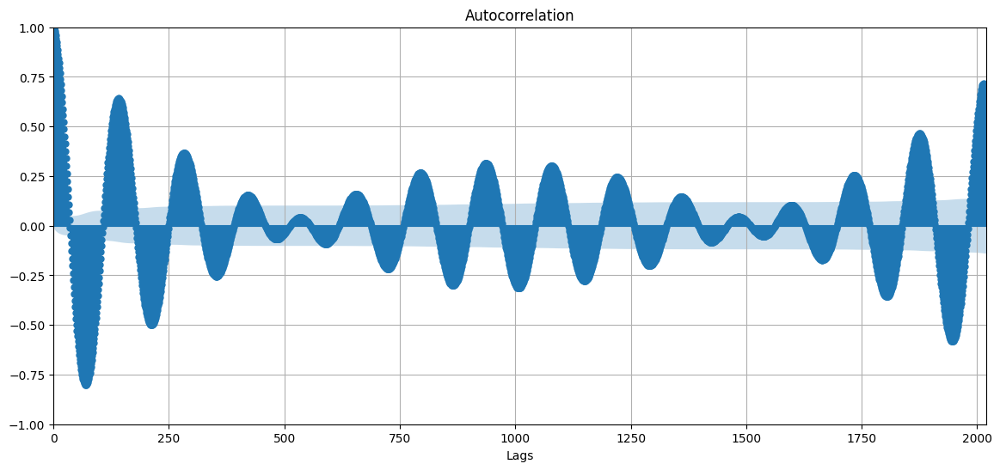

In [ ]:
figure, ax = plt.subplots(figsize=(14,6))
plot_acf(x=df, lags=3000, ax=ax)
plt.xlabel('Lags')
plt.xlim(0,2020)
plt.grid()

acf_ary = acf(x=df, nlags=350)
print(acf_ary[330:339])

PEAKS

                       YValue  Seasonal_336     Trend  Residual  \
DateTime                                                          
2021-04-07 00:00:00 -0.095846      0.057623 -0.084070 -0.069398   
2021-04-07 00:10:00  0.028053      0.181624 -0.084057 -0.069514   
2021-04-07 00:20:00  0.089668      0.254319 -0.084044 -0.080608   
2021-04-07 00:30:00  0.152151      0.327327 -0.084031 -0.091146   
2021-04-07 00:40:00  0.214159      0.386967 -0.084017 -0.088791   
...                       ...           ...       ...       ...   
2021-12-05 03:50:00  0.078069      0.156876  0.003605 -0.082412   
2021-12-05 04:00:00  0.078069      0.155033  0.003600 -0.080563   
2021-12-05 04:10:00  0.058938      0.138679  0.003594 -0.083335   
2021-12-05 04:20:00  0.058938      0.137359  0.003588 -0.082010   
2021-12-05 04:30:00  0.038445      0.119844  0.003583 -0.084982   

                     Target-After 14D     Peaks  
DateTime                                         
2021-04-07 00:00:00         

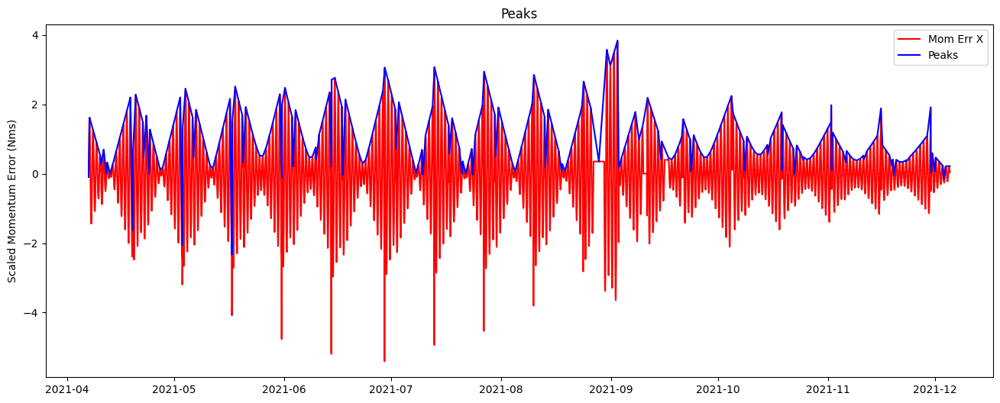

In [ ]:
peaks_train, _ = find_peaks(train_df_scaled['YValue'])
train_df_scaled['Peaks']=train_df_scaled['YValue'][peaks_train]
train_df_scaled['Peaks'][0]=train_df_scaled['YValue'][0]
train_df_scaled = train_df_scaled.interpolate()
plt.figure(figsize=(16,6))
plt.plot(train_df_scaled['YValue'], color = 'red', label = 'Mom Err X')
plt.plot(train_df_scaled['Peaks'], color = 'blue', label = 'Peaks')
plt.title('Peaks')
plt.ylabel('Scaled Momentum Error (Nms)')
plt.legend()
print(train_df_scaled)

peaks_valid, _ = find_peaks(valid_df_scaled['YValue'])
valid_df_scaled['Peaks']=valid_df_scaled['YValue'][peaks_valid]
valid_df_scaled['Peaks'][0]=valid_df_scaled['YValue'][0]
valid_df_scaled = valid_df_scaled.interpolate()

peaks_test, _ = find_peaks(test_df_scaled['YValue'])
test_df_scaled['Peaks']=test_df_scaled['YValue'][peaks_test]
test_df_scaled['Peaks'][0]=test_df_scaled['YValue'][0]
test_df_scaled = test_df_scaled.interpolate()

HOUR, DAY, MONTH

In [ ]:
train_df_scaled['Hour'] = train_df_scaled.index.hour
valid_df_scaled['Hour'] = valid_df_scaled.index.hour
test_df_scaled['Hour'] = test_df_scaled.index.hour
train_df_scaled['Day'] = train_df_scaled.index.day
valid_df_scaled['Day'] = valid_df_scaled.index.day
test_df_scaled['Day'] = test_df_scaled.index.day
train_df_scaled['Month'] = train_df_scaled.index.month
valid_df_scaled['Month'] = valid_df_scaled.index.month
test_df_scaled['Month'] = test_df_scaled.index.month
print(train_df_scaled)

                       YValue  Seasonal_336     Trend  Residual  \
DateTime                                                          
2021-04-07 00:00:00 -0.095846      0.057623 -0.084070 -0.069398   
2021-04-07 00:10:00  0.028053      0.181624 -0.084057 -0.069514   
2021-04-07 00:20:00  0.089668      0.254319 -0.084044 -0.080608   
2021-04-07 00:30:00  0.152151      0.327327 -0.084031 -0.091146   
2021-04-07 00:40:00  0.214159      0.386967 -0.084017 -0.088791   
...                       ...           ...       ...       ...   
2021-12-05 03:50:00  0.078069      0.156876  0.003605 -0.082412   
2021-12-05 04:00:00  0.078069      0.155033  0.003600 -0.080563   
2021-12-05 04:10:00  0.058938      0.138679  0.003594 -0.083335   
2021-12-05 04:20:00  0.058938      0.137359  0.003588 -0.082010   
2021-12-05 04:30:00  0.038445      0.119844  0.003583 -0.084982   

                     Target-After 14D     Peaks  Hour  Day  Month  
DateTime                                                    

PEARSON CORRELATION ANALYSIS

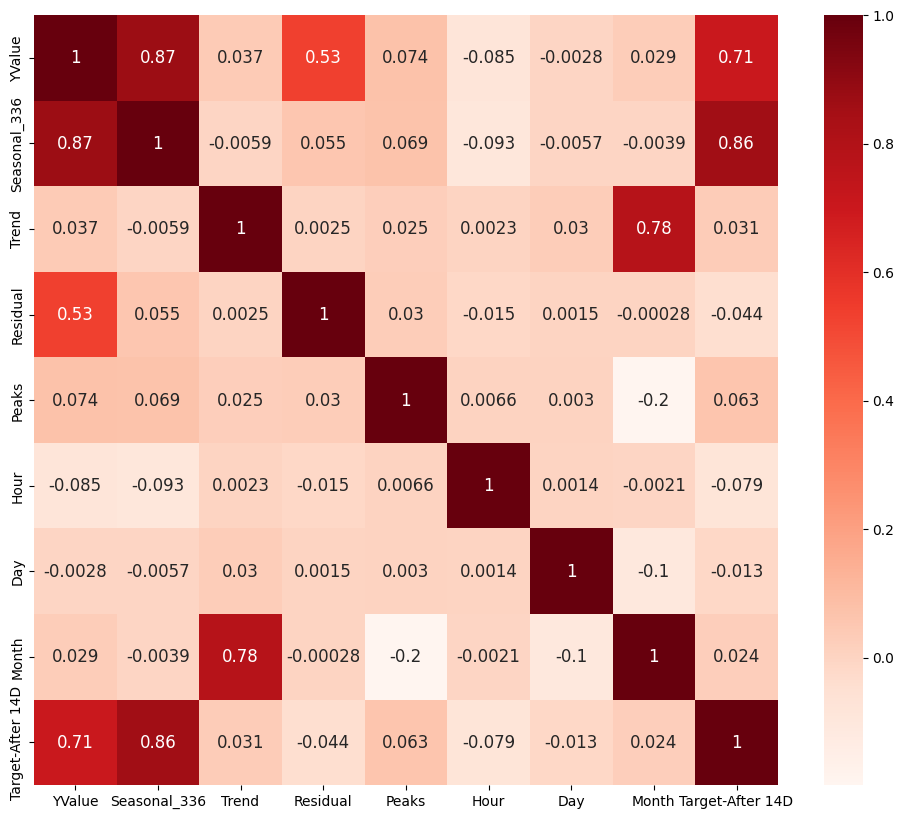

In [ ]:
#Using Pearson Correlation
train_df_scaled = train_df_scaled[['YValue', 'Seasonal_336', 'Trend', 'Residual', 'Peaks', 'Hour', 'Day', 'Month', 'Target-After 14D']]
plt.figure(figsize=(12,10))
cor = train_df_scaled.corr()
sns.heatmap(cor, annot=True, annot_kws={"size": 12}, cmap=plt.cm.Reds)
plt.show()

# Data Preprocessing - PART 2 (Feature Engineering - Must)

LAG

In [ ]:
#Create the target dataframe, which is the one-week-shifted version of original input dataframe
hours_in_two_weeks = 24*14
train_df_target = train_df_scaled.shift(-hours_in_two_weeks)
valid_df_target = valid_df_scaled.shift(-hours_in_two_weeks)
test_df_target = test_df_scaled.shift(-hours_in_two_weeks)
print(train_df_scaled.shape)
print(valid_df_scaled.shape)
print(test_df_scaled.shape)

(6148, 1)
(2636, 1)
(8760, 1)


TIME SERIES DECOMPOSITION

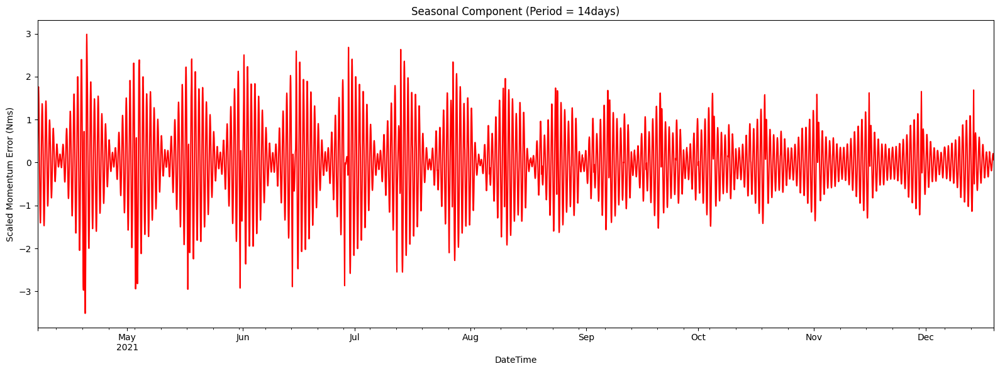

In [ ]:
res_train = MSTL(train_df_scaled, periods = hours_in_two_weeks).fit()
res_valid = MSTL(valid_df_scaled, periods = hours_in_two_weeks).fit()
res_test = MSTL(test_df_scaled, periods = hours_in_two_weeks).fit()
plt.figure(figsize=(16,6))
plt.title('Seasonal Component (Period = 14days)')
plt.ylabel('Scaled Momentum Error (Nms)')
res_train.seasonal.plot(color = 'red')
# plt.figure(figsize=(16,6))
# plt.title('Trend Component')
# plt.ylabel('Scaled Momentum Error (Nms)')
# res_train.trend.plot(color = 'blue' )
# plt.figure(figsize=(16,6))
# plt.title('Residual Component')
# plt.ylabel('Scaled Momentum Error (Nms)')
# res_train.resid.plot(color = 'purple' )
plt.tight_layout()
plt.show()
train_df_scaled['Seasonal_336'] = res_train.seasonal
valid_df_scaled['Seasonal_336'] = res_valid.seasonal
test_df_scaled['Seasonal_336'] = res_test.seasonal
# train_df_scaled['Trend'] = res_train.trend
# valid_df_scaled['Trend'] = res_valid.trend
# test_df_scaled['Trend'] = res_test.trend
# train_df_scaled['Residual'] = res_train.resid
# valid_df_scaled['Residual'] = res_valid.resid
# test_df_scaled['Residual'] = res_test.resid

Add the lagged data

In [ ]:
# train_df_scaled["Target-After 14D"] = train_df_target
# train_df_scaled = train_df_scaled.dropna()
# valid_df_scaled["Target-After 14D"] = valid_df_target
# valid_df_scaled = valid_df_scaled.dropna()
# test_df_scaled["Target-After 14D"] = test_df_target
# test_df_scaled = test_df_scaled.dropna()
print(train_df_scaled)

                       YValue  Seasonal_336
DateTime                                   
2021-04-07 00:00:00 -0.093162      0.061474
2021-04-07 01:00:00  0.402422      0.559631
2021-04-07 02:00:00  0.774139      0.961490
2021-04-07 03:00:00  1.145648      1.330157
2021-04-07 04:00:00  1.394631      1.580418
...                       ...           ...
2021-12-18 23:00:00  0.100736      0.208004
2021-12-19 00:00:00  0.106494      0.192469
2021-12-19 01:00:00  0.104520      0.160649
2021-12-19 02:00:00  0.092788      0.114152
2021-12-19 03:00:00  0.076109      0.063387

[6148 rows x 2 columns]


Convert to numpy array

In [ ]:
train_df_target = train_df_target[0:-hours_in_two_weeks]
train_df_scaled = train_df_scaled.drop(columns = ['YValue'])[0:-hours_in_two_weeks]
valid_df_target = valid_df_target[0:-hours_in_two_weeks]
valid_df_scaled = valid_df_scaled.drop(columns = ['YValue'])[0:-hours_in_two_weeks]
test_df_target = test_df_target[0:-hours_in_two_weeks]
test_df_scaled = test_df_scaled.drop(columns = ['YValue'])[0:-hours_in_two_weeks]

x_train_scaled = np.array(train_df_scaled)
y_train_scaled = np.array(train_df_target)
x_valid_scaled = np.array(valid_df_scaled)
y_valid_scaled = np.array(valid_df_target)
x_data_scaled = np.array(test_df_scaled)
y_data_scaled = np.array(test_df_target)
print(x_train_scaled.shape)
print(x_valid_scaled.shape)
print(x_data_scaled.shape)
print(y_train_scaled.shape)
print(y_valid_scaled.shape)
print(y_data_scaled.shape)

(5812, 1)
(2300, 1)
(8424, 1)
(5812, 1)
(2300, 1)
(8424, 1)


Prepare unscaled target value for test set, for model evaluation later.

In [ ]:
test_df_shift = test_df.shift(-hours_in_two_weeks)
y_data2 = test_df_shift[0:-hours_in_two_weeks]
y_test2 = np.array(y_data2)

# Data Preprocessing - PART 3 (Data Generator)

In [ ]:
def batch_generator(batch_size, sequence_length, x_set, y_set):
    """
    Generator function for creating random batches of training-data.
    """

    # Infinite loop.
    while True:
        # Allocate a new array for the batch of input-signals.
        x_shape = (batch_size, sequence_length, x_set.shape[1])
        x_batch = np.zeros(shape=x_shape, dtype=np.float16)

        # Allocate a new array for the batch of output-signals.
        y_shape = (batch_size, sequence_length, y_set.shape[1])
        y_batch = np.zeros(shape=y_shape, dtype=np.float16)

        # Fill the batch with random sequences of data.
        for i in range(batch_size):
            # Get a random start-index.
            # This points somewhere into the training-data.
            idx = np.random.randint(x_set.shape[0] - sequence_length)

            # Copy the sequences of data starting at this index.
            x_batch[i] = x_set[idx:idx+sequence_length]
            y_batch[i] = y_set[idx:idx+sequence_length]

        yield (x_batch, y_batch)

In [ ]:
generator = batch_generator(batch_size=256, sequence_length=50, x_set=x_train_scaled, y_set=y_train_scaled)
generator_test = batch_generator(batch_size=256, sequence_length=50, x_set=x_data_scaled, y_set=y_data_scaled)
generator_valid = batch_generator(batch_size=256, sequence_length=50, x_set=x_valid_scaled, y_set=y_valid_scaled)

# Model Training - Part 1 (Must)

In [ ]:
warmup_step = 25
def loss_mse_warmup(y_true, y_pred):
    """
    Calculate the Mean Squared Error between y_true and y_pred,
    but ignore the beginning "warmup" part of the sequences.

    y_true is the desired output.
    y_pred is the model's output.
    """

    # The shape of both input tensors are:
    # [batch_size, sequence_length, num_y_signals].

    # Ignore the "warmup" parts of the sequences
    # by taking slices of the tensors.
    y_true_slice = y_true[:, warmup_step:, :]
    y_pred_slice = y_pred[:, warmup_step:, :]

    # These sliced tensors both have this shape:
    # [batch_size, sequence_length - warmup_steps, num_y_signals]

    # Calculate the Mean Squared Error and use it as loss.
    mse = mean_squared_error(y_true_slice, y_pred_slice)

    return mse

In [ ]:
# The same LSTM model I would like to test, lets see if the sinus prediction results can be matched
# Note: replace LSTM with GRU or RNN if you want to try those
def build_model(model_type, activ_fx, dropout, opt):
  model = Sequential()

  if model_type == 'GRU':
    model.add(GRU(50, return_sequences=True, input_shape=(None, x_train_scaled.shape[1]))) #The None here will be the second element of the shape of the output
    model.add(Dropout(dropout))
    model.add(GRU(100, return_sequences=True))
    model.add(Dropout(dropout))
    model.add(Dense(1, activation = activ_fx))

  if model_type == 'LSTM':
    model.add(LSTM(50, return_sequences=True, input_shape=(None,x_train_scaled.shape[1])))
    model.add(Dropout(dropout))
    model.add(LSTM(100, return_sequences=True))
    model.add(Dropout(dropout))
    model.add(Dense(1, activation = activ_fx))

  if model_type == 'RNN':
    model.add(SimpleRNN(50, return_sequences=True, input_shape=(None,x_train_scaled.shape[1])))
    model.add(Dropout(dropout))
    model.add(SimpleRNN(100, return_sequences=True))
    model.add(Dropout(dropout))
    model.add(Dense(1, activation = activ_fx))

  if model_type == 'Bi-LSTM':
    model.add(Bidirectional(LSTM(50, return_sequences=True), input_shape=(None,x_train_scaled.shape[1])))
    model.add(Dropout(dropout))
    model.add(Bidirectional(LSTM(100, return_sequences=True)))
    model.add(Dropout(dropout))
    model.add(Dense(1, activation = activ_fx))

  model.compile(loss= loss_mse_warmup, optimizer=opt)
  print (model_type, " model compiled")
  # print (model.summary())
  return model

In [ ]:
def return_mse(test,predicted):
    mse = mean_squared_error(test, predicted)
    rmse = math.sqrt(mse)
    mae = mean_absolute_error(test, predicted)
    mape = mean_absolute_percentage_error(test, predicted)
    r2 = r2_score(test, predicted)
    # print("The mean squared error is {}.".format(mse))
    print("The root mean squared error is {}.".format(rmse))
    # print("The mean absolute error is {}.".format(mae))
    # print("The mean absolute percentage error is {}.".format(mape))
    print("The r2 score is {}.".format(r2))
    return mse, rmse, mae, mape, r2

In [ ]:
np.random.seed(123)
random.seed(123)
tf.random.set_seed(123)
model_lstm_2 = build_model("RNN", "linear", 0.2, RMSprop(learning_rate=0.001))

RNN  model compiled


In [ ]:
x_valid_scaled = np.expand_dims(x_valid_scaled, axis=0)
y_valid_scaled = np.expand_dims(y_valid_scaled, axis=0)
x_data_scaled = np.expand_dims(x_data_scaled, axis=0)
print(x_valid_scaled.shape)
print(y_valid_scaled.shape)
print(x_data_scaled.shape)

(1, 2300, 1)
(1, 2300, 1)
(1, 8424, 1)


In [ ]:
path_checkpoint = '23_checkpoint.keras'
callback_checkpoint = ModelCheckpoint(filepath=path_checkpoint,
                                      monitor='val_loss',
                                      verbose=1,
                                      save_weights_only=True,
                                      save_best_only=True)

callback_early_stopping = EarlyStopping(monitor='val_loss',
                                        patience=5, verbose=1)

callback_tensorboard = TensorBoard(log_dir='./23_logs/',
                                   histogram_freq=0,
                                   write_graph=False)

callback_reduce_lr = ReduceLROnPlateau(monitor='val_loss',
                                       factor=0.1,
                                       min_lr=1e-4,
                                       patience=0,
                                       verbose=1)

callbacks = [callback_early_stopping,
             callback_checkpoint,
             callback_tensorboard,
             callback_reduce_lr]

In [ ]:
history = model_lstm_2.fit(generator, epochs=50, steps_per_epoch=150, validation_data=(x_valid_scaled, y_valid_scaled), callbacks=callbacks)

Epoch 1/50
150/150 [==============================] - ETA: 0s - loss: 0.3406
Epoch 1: val_loss improved from inf to 0.04761, saving model to 23_checkpoint.keras
150/150 [==============================] - 16s 95ms/step - loss: 0.3406 - val_loss: 0.0476 - lr: 0.0010
Epoch 2/50
150/150 [==============================] - ETA: 0s - loss: 0.2821
Epoch 2: val_loss improved from 0.04761 to 0.03534, saving model to 23_checkpoint.keras
150/150 [==============================] - 14s 95ms/step - loss: 0.2821 - val_loss: 0.0353 - lr: 0.0010
Epoch 3/50
150/150 [==============================] - ETA: 0s - loss: 0.2703
Epoch 3: val_loss improved from 0.03534 to 0.03337, saving model to 23_checkpoint.keras
150/150 [==============================] - 14s 94ms/step - loss: 0.2703 - val_loss: 0.0334 - lr: 0.0010
Epoch 4/50
150/150 [==============================] - ETA: 0s - loss: 0.2675
Epoch 4: val_loss did not improve from 0.03337

Epoch 4: ReduceLROnPlateau reducing learning rate to 0.00010000000474974

dict_keys(['loss', 'val_loss', 'lr'])


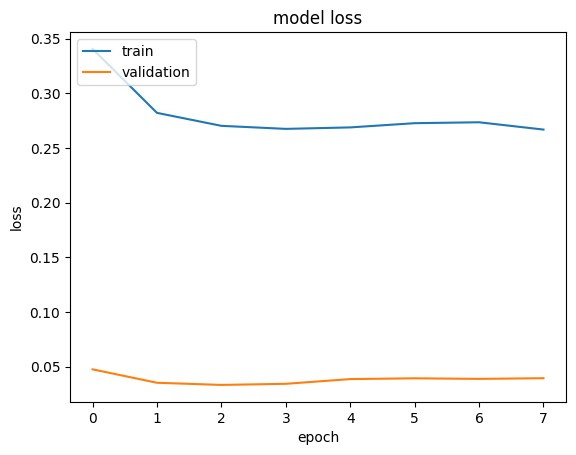

In [ ]:
print(history.history.keys())
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

# Model Training - PART 2 (Hyperparameter Tuning, Optional)

In [ ]:
def hyperparamtuning(hp):
  model_type = hp.Choice("model_type", ["gru", "lstm", "rnn", "bi-lstm"])
  activ_fx = "linear"
  #hp.Choice("activ_fx", ["linear", "relu"])
  dropout = hp.Float("dropout", min_value=0.2, max_value=0.5, step=0.1)

  lr = 0.001
  # hp.Float("lr", min_value=1e-4, max_value=1e-2, step = 10, sampling="log")
  optimizer = hp.Choice("optimizer", ["RMSprop", "Adam"])
  with hp.conditional_scope("optimizer", ["RMSprop"]):
    if optimizer == "RMSprop":
      opt = RMSprop(learning_rate=lr)
  with hp.conditional_scope("optimizer", ["Adam"]):
    if optimizer == "Adam":
      opt = Adam(learning_rate=lr)

  with hp.conditional_scope("model_type", ["gru"]):
      if model_type == "gru":
        model = build_model("GRU", activ_fx, dropout, opt)
  with hp.conditional_scope("model_type", ["lstm"]):
      if model_type == "lstm":
        model = build_model("LSTM", activ_fx, dropout, opt)
  with hp.conditional_scope("model_type", ["rnn"]):
      if model_type == "rnn":
        model = build_model("RNN", activ_fx, dropout, opt)
  with hp.conditional_scope("model_type", ["bi-lstm"]):
      if model_type == "bi-lstm":
        model = build_model("Bi-LSTM", activ_fx, dropout, opt)

  return model

In [ ]:
hyperparamtuning(keras_tuner.HyperParameters())

In [ ]:
tuner = keras_tuner.BayesianOptimization(
    hypermodel=hyperparamtuning,
    objective="val_loss",
    max_trials=32,
    seed=123,
    executions_per_trial=1,
    overwrite=True,
    directory="/tmp/tb"
)
tuner.search_space_summary()

GRU  model compiled
GRU  model compiled
LSTM  model compiled
RNN  model compiled
Bi-LSTM  model compiled
LSTM  model compiled
RNN  model compiled
Bi-LSTM  model compiled
RNN  model compiled
Bi-LSTM  model compiled
Bi-LSTM  model compiled
Search space summary
Default search space size: 3
model_type (Choice)
{'default': 'gru', 'conditions': [], 'values': ['gru', 'lstm', 'rnn', 'bi-lstm'], 'ordered': False}
dropout (Float)
{'default': 0.2, 'conditions': [], 'min_value': 0.2, 'max_value': 0.5, 'step': 0.1, 'sampling': 'linear'}
optimizer (Choice)
{'default': 'RMSprop', 'conditions': [], 'values': ['RMSprop', 'Adam'], 'ordered': False}


In [ ]:
tuner.search(generator, epochs=20, steps_per_epoch=10, validation_data=generator_test, validation_steps=10, callbacks=[keras.callbacks.TensorBoard("/tmp/tb_logs")])

Trial 32 Complete [00h 02m 29s]
val_loss: 0.10785479843616486

Best val_loss So Far: 0.09237442910671234
Total elapsed time: 01h 13m 21s


In [ ]:
tuner.results_summary()
# Results summary
# Results in /tmp/tb/untitled_project
# Showing 10 best trials
# Objective(name="val_loss", direction="min")

# Trial 23 summary
# Hyperparameters:
# model_type: rnn
# dropout: 0.2
# optimizer: Adam
# Score: 0.08920176327228546

# Trial 05 summary
# Hyperparameters:
# model_type: rnn
# dropout: 0.30000000000000004
# optimizer: Adam
# Score: 0.09004148840904236

# Trial 11 summary
# Hyperparameters:
# model_type: gru
# dropout: 0.4
# optimizer: RMSprop
# Score: 0.09436538815498352

#2nd try
# Trial 23 summary
# Hyperparameters:
# model_type: rnn
# dropout: 0.2
# optimizer: Adam
# Score: 0.09237442910671234

# Trial 09 summary
# Hyperparameters:
# model_type: rnn
# dropout: 0.2
# optimizer: RMSprop
# Score: 0.09241349995136261

# Trial 20 summary
# Hyperparameters:
# model_type: gru
# dropout: 0.30000000000000004
# optimizer: Adam
# Score: 0.09377875179052353

Results summary
Results in /tmp/tb/untitled_project
Showing 10 best trials
Objective(name="val_loss", direction="min")

Trial 23 summary
Hyperparameters:
model_type: rnn
dropout: 0.2
optimizer: Adam
Score: 0.09237442910671234

Trial 09 summary
Hyperparameters:
model_type: rnn
dropout: 0.2
optimizer: RMSprop
Score: 0.09241349995136261

Trial 20 summary
Hyperparameters:
model_type: gru
dropout: 0.30000000000000004
optimizer: Adam
Score: 0.09377875179052353

Trial 16 summary
Hyperparameters:
model_type: rnn
dropout: 0.2
optimizer: Adam
Score: 0.09502913057804108

Trial 13 summary
Hyperparameters:
model_type: rnn
dropout: 0.4
optimizer: Adam
Score: 0.09572221338748932

Trial 25 summary
Hyperparameters:
model_type: rnn
dropout: 0.4
optimizer: RMSprop
Score: 0.09664014726877213

Trial 04 summary
Hyperparameters:
model_type: gru
dropout: 0.2
optimizer: Adam
Score: 0.09741072356700897

Trial 01 summary
Hyperparameters:
model_type: rnn
dropout: 0.2
optimizer: Adam
Score: 0.09802479296922684

Tr

In [ ]:
%load_ext tensorboard

%tensorboard --logdir /tmp/tb_logs

<IPython.core.display.Javascript object>

# Model Evaluation

In [ ]:
def plot_comparison(start_idx, length=100, train=False, plot=True):
    """
    Plot the predicted and true output-signals.

    :param start_idx: Start-index for the time-series.
    :param length: Sequence-length to process and plot.
    :param train: Boolean whether to use training- or test-set.
    """

    if train:
        # Use training-data.
        x = x_train_scaled
        y_true = y_train
    else:
        # Use test-data.
        x = x_data_scaled
        y_true = y_test2

    # End-index for the sequences.
    end_idx = start_idx + length

    # Select the sequences from the given start-index and
    # of the given length.
    x = x[:, start_idx:end_idx]
    y_true = y_true[start_idx:end_idx]

    # Use the model to predict the output-signals.
    y_pred = model_lstm_2.predict(x)
    y_pred = np.squeeze(y_pred, axis=0)
    x = np.squeeze(x, axis=0)

    # The output of the model is between 0 and 1.
    # Do an inverse map to get it back to the scale
    # of the original data-set.
    y_pred_rescaled = y_pred * test_std + test_mean


    if plot:
          # Make the plotting-canvas bigger.
      plt.figure(figsize=(15,5))

      # noise = np.random.normal(np.mean(y_true),np.std(y_true),size=y_true.shape)
      # print(y_true.shape)
      # print(noise.shape)
      # print((y_true+noise).shape)

          # Plot and compare the two signals.
      x2 = y_data2.index[start_idx:end_idx] + pd.Timedelta('14 days')
      print(x2[0])
      print(x2[-1])
      plt.plot(x2, y_true, label='true')
      plt.plot(x2, y_pred_rescaled, label='pred')
      # plt.scatter(y_pred_rescaled, y_true-y_pred_rescaled, label='error')

      print("The first predicted value is ", y_pred_rescaled[0])
      print("The first actual value is ", y_true[0])

      # # Plot grey box for warmup-period.
      # p = plt.axvspan(0, warmup_step, facecolor='black', alpha=0.15)

      # Plot labels etc.
      # plt.xlabel("Fitted Value")
      # plt.ylabel("Residual")
      plt.xlabel("Date")
      plt.ylabel("Mom Err (Nms)")
      # plt.yticks([-10, -8, -6, -4, -2, 0, 2, 4, 6, 8, 10])
      plt.grid()
      plt.legend()
      plt.show()

    tss=0
    rss=0
    ss=0
    for element in range(len(y_true)):
      tss = tss + (y_true[element] - np.mean(y_true))**2
      rss = rss + (y_pred_rescaled[element] - np.mean(y_true))**2
      ss = ss + (y_true[element]-y_pred_rescaled[element])*(y_pred_rescaled[element]-np.mean(y_true))

    errors = return_mse(y_true, y_pred_rescaled)
    sse = errors[0]*len(y_true)
    print(len(y_true))
    print(rss+sse+2*ss)
    print(tss)
    return errors

In [ ]:
start_index = []
for i in range(7,(x_data_scaled.shape[1]//(24)+1)):
  start_index.append(x_data_scaled.shape[1] - i*24)
print(start_index)

[8256, 8232, 8208, 8184, 8160, 8136, 8112, 8088, 8064, 8040, 8016, 7992, 7968, 7944, 7920, 7896, 7872, 7848, 7824, 7800, 7776, 7752, 7728, 7704, 7680, 7656, 7632, 7608, 7584, 7560, 7536, 7512, 7488, 7464, 7440, 7416, 7392, 7368, 7344, 7320, 7296, 7272, 7248, 7224, 7200, 7176, 7152, 7128, 7104, 7080, 7056, 7032, 7008, 6984, 6960, 6936, 6912, 6888, 6864, 6840, 6816, 6792, 6768, 6744, 6720, 6696, 6672, 6648, 6624, 6600, 6576, 6552, 6528, 6504, 6480, 6456, 6432, 6408, 6384, 6360, 6336, 6312, 6288, 6264, 6240, 6216, 6192, 6168, 6144, 6120, 6096, 6072, 6048, 6024, 6000, 5976, 5952, 5928, 5904, 5880, 5856, 5832, 5808, 5784, 5760, 5736, 5712, 5688, 5664, 5640, 5616, 5592, 5568, 5544, 5520, 5496, 5472, 5448, 5424, 5400, 5376, 5352, 5328, 5304, 5280, 5256, 5232, 5208, 5184, 5160, 5136, 5112, 5088, 5064, 5040, 5016, 4992, 4968, 4944, 4920, 4896, 4872, 4848, 4824, 4800, 4776, 4752, 4728, 4704, 4680, 4656, 4632, 4608, 4584, 4560, 4536, 4512, 4488, 4464, 4440, 4416, 4392, 4368, 4344, 4320, 4296, 427

In [ ]:
nssk_date = []
ewsk_date = []
maneuver_df = pd.read_csv(maneuver_path)
for index, row in maneuver_df.iterrows():
  if row['SK'] == 'NSSK':
    nssk_date.append(pd.to_datetime(row['Manoeuvre Start Time (UTC)'], format='%d/%m/%Y %H:%M').date())
  if row['SK'] == 'EWSK':
    ewsk_date.append(pd.to_datetime(row['Manoeuvre Start Time (UTC)'], format='%d/%m/%Y %H:%M').date())
print(nssk_date)

[datetime.date(2020, 4, 6), datetime.date(2020, 4, 20), datetime.date(2020, 5, 4), datetime.date(2020, 5, 18), datetime.date(2020, 6, 1), datetime.date(2020, 6, 15), datetime.date(2020, 6, 30), datetime.date(2020, 7, 14), datetime.date(2020, 7, 28), datetime.date(2020, 8, 11), datetime.date(2020, 8, 25), datetime.date(2020, 9, 8), datetime.date(2020, 9, 21), datetime.date(2020, 10, 5), datetime.date(2020, 10, 19), datetime.date(2020, 11, 2), datetime.date(2020, 11, 16), datetime.date(2020, 11, 30), datetime.date(2020, 12, 14), datetime.date(2020, 12, 28), datetime.date(2021, 1, 11), datetime.date(2021, 1, 25), datetime.date(2021, 2, 8), datetime.date(2021, 2, 22), datetime.date(2021, 3, 8), datetime.date(2021, 3, 22), datetime.date(2021, 4, 5)]


8208
1/1 [==============================] - 0s 391ms/step
2021-03-29 00:00:00
2021-04-04 23:00:00
The first predicted value is  [0.64772767]
The first actual value is  [-0.2357506]


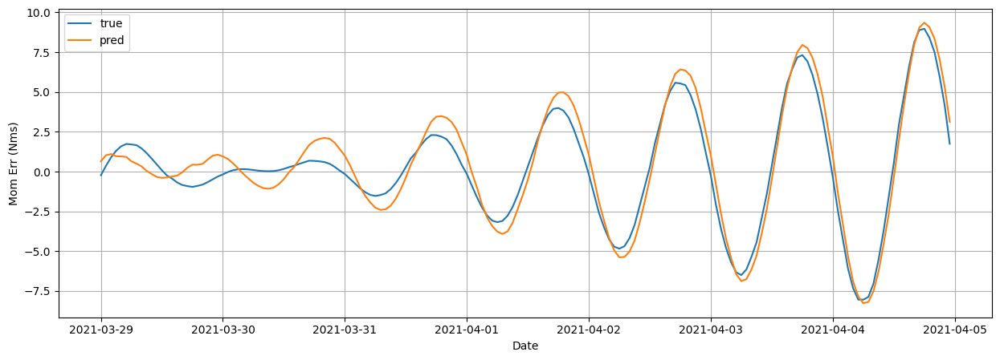

The root mean squared error is 0.8971582376409263.
The r2 score is 0.9329021610956527.
168
[2015.29566097]
[2015.29602106]
8184
1/1 [==============================] - 0s 38ms/step
2021-03-28 00:00:00
2021-04-03 23:00:00
The first predicted value is  [0.56376576]
The first actual value is  [-0.3158566]


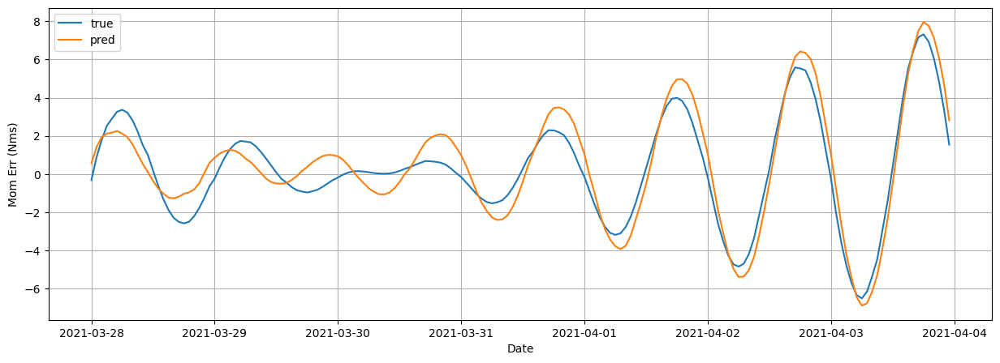

The root mean squared error is 0.9329456625357196.
The r2 score is 0.8816040266221044.
168
[1235.05155249]
[1235.05144796]
8160
1/1 [==============================] - 0s 32ms/step
2021-03-27 00:00:00
2021-04-02 23:00:00
The first predicted value is  [0.44886062]
The first actual value is  [-0.4188269]


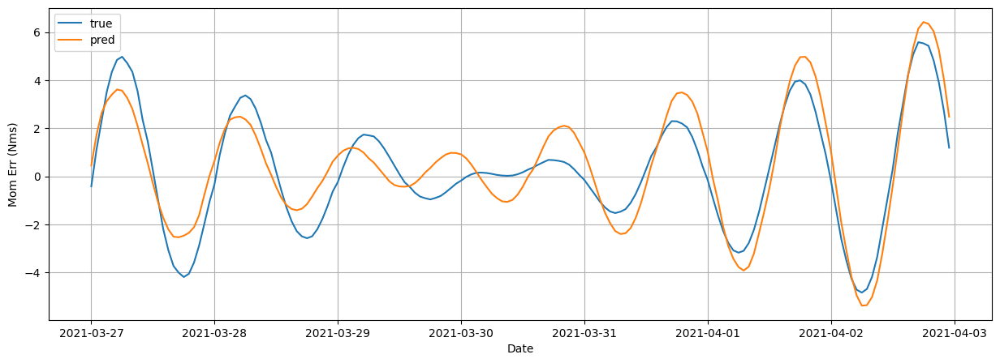

The root mean squared error is 0.9740489929564505.
The r2 score is 0.8259053246642852.
168
[915.55710952]
[915.55701934]
8136
1/1 [==============================] - 0s 33ms/step
2021-03-26 00:00:00
2021-04-01 23:00:00
The first predicted value is  [0.27541074]
The first actual value is  [-0.5640235]


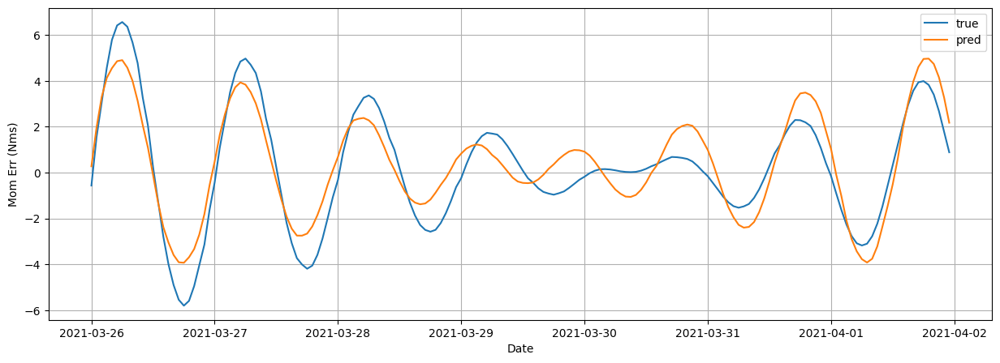

The root mean squared error is 1.0288285380859423.
The r2 score is 0.8291045783524252.
168
[1040.55461987]
[1040.55456429]
7872
1/1 [==============================] - 0s 31ms/step
2021-03-15 00:00:00
2021-03-21 23:00:00
The first predicted value is  [0.67620265]
The first actual value is  [0.9114736]


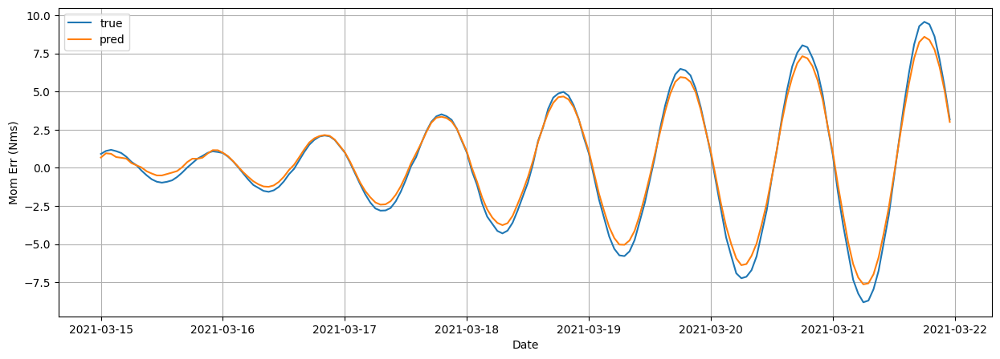

The root mean squared error is 0.4559896248501838.
The r2 score is 0.9866021220510619.
168
[2607.25315243]
[2607.25306741]
7848
1/1 [==============================] - 0s 37ms/step
2021-03-14 00:00:00
2021-03-20 23:00:00
The first predicted value is  [0.5970323]
The first actual value is  [0.8359218]


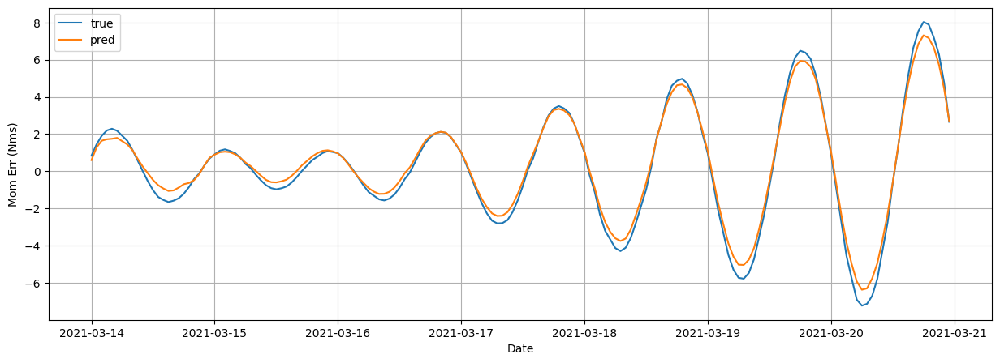

The root mean squared error is 0.3753741855792066.
The r2 score is 0.9855119198797095.
168
[1633.90663041]
[1633.90668114]
7824
1/1 [==============================] - 0s 116ms/step
2021-03-13 00:00:00
2021-03-19 23:00:00
The first predicted value is  [0.48921904]
The first actual value is  [0.7212379]


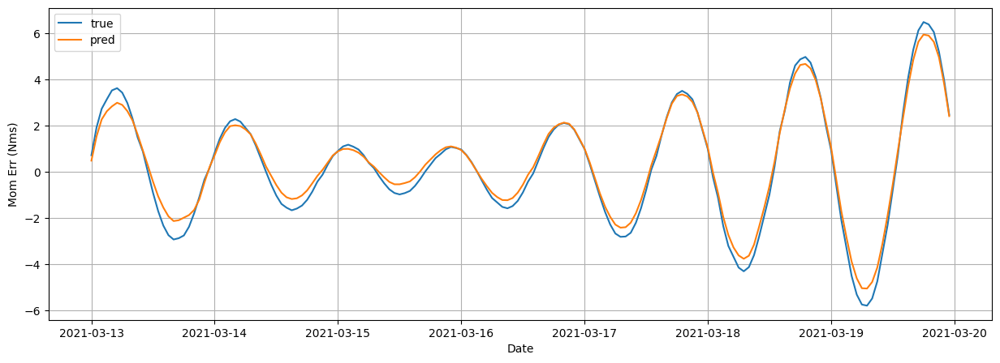

The root mean squared error is 0.34235972424291583.
The r2 score is 0.9813351865328116.
168
[1054.99634883]
[1054.99636556]
7800
1/1 [==============================] - 0s 44ms/step
2021-03-12 00:00:00
2021-03-18 23:00:00
The first predicted value is  [0.3169197]
The first actual value is  [0.5890408]


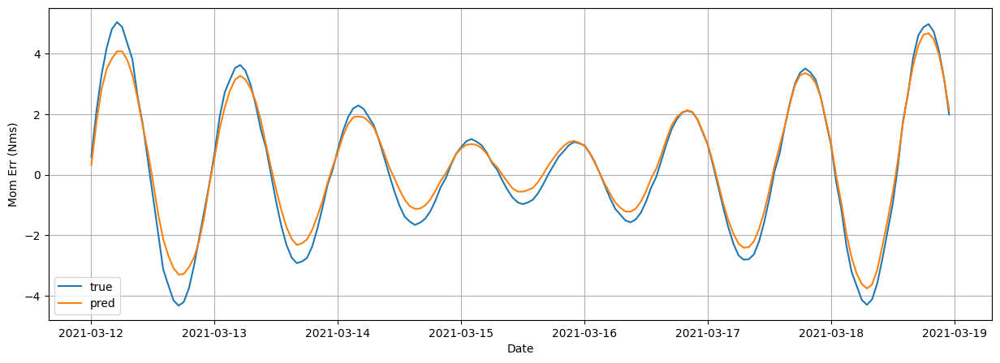

The root mean squared error is 0.3712571845341577.
The r2 score is 0.9729158179778488.
168
[854.95506352]
[854.95506892]
7536
1/1 [==============================] - 0s 27ms/step
2021-03-01 00:00:00
2021-03-07 23:00:00
The first predicted value is  [0.6975318]
The first actual value is  [0.9170817]


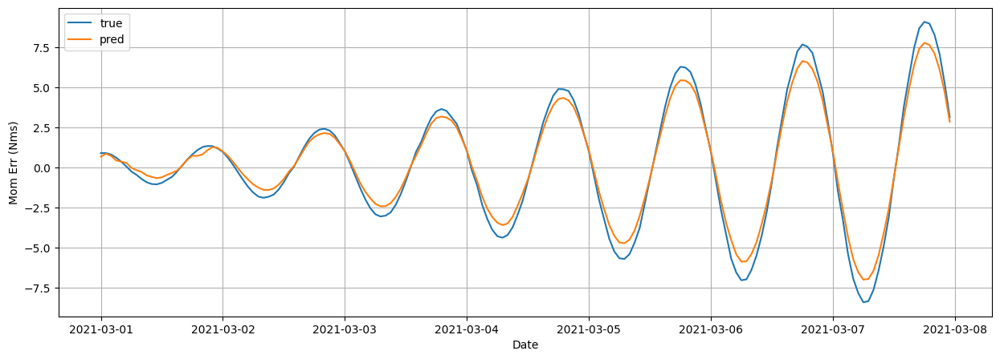

The root mean squared error is 0.6049394606132147.
The r2 score is 0.9752577682750583.
168
[2484.81612583]
[2484.81603651]
7512
1/1 [==============================] - 0s 33ms/step
2021-02-28 00:00:00
2021-03-06 23:00:00
The first predicted value is  [0.62294936]
The first actual value is  [0.8348069]


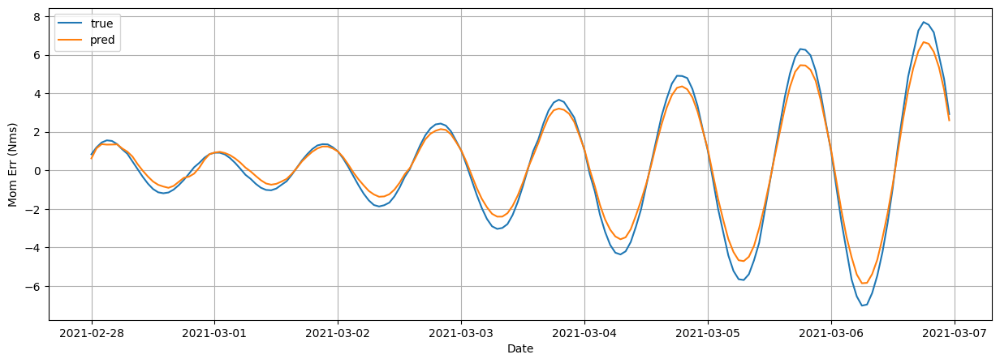

The root mean squared error is 0.4880594570298544.
The r2 score is 0.9746645981227651.
168
[1579.52678651]
[1579.52661805]
7488
1/1 [==============================] - 0s 36ms/step
2021-02-27 00:00:00
2021-03-05 23:00:00
The first predicted value is  [0.5218631]
The first actual value is  [0.7323978]


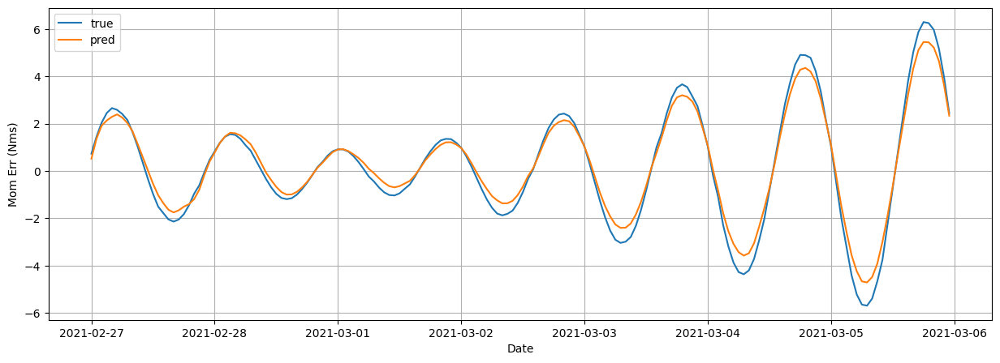

The root mean squared error is 0.39578743894073737.
The r2 score is 0.9735297422306114.
168
[994.20311759]
[994.20312774]
1/1 [==============================] - 0s 33ms/step
2021-02-26 00:00:00
2021-03-04 23:00:00
The first predicted value is  [0.3536585]
The first actual value is  [0.602143]


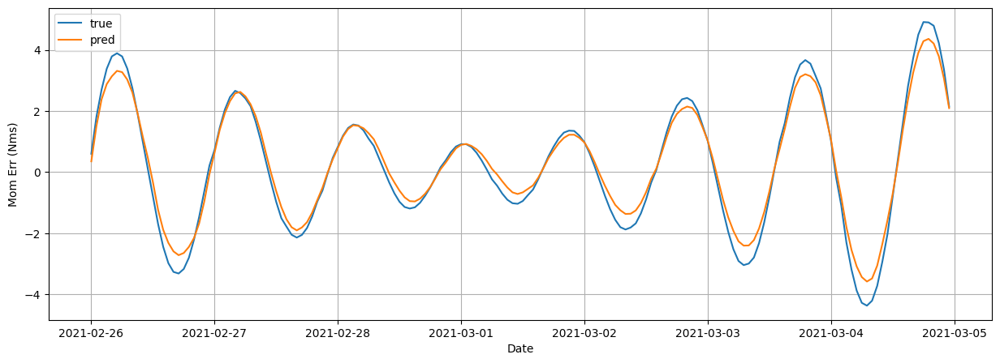

The root mean squared error is 0.34125289848224216.
The r2 score is 0.97241807860804.
168
[709.31227405]
[709.31225433]
1/1 [==============================] - 0s 29ms/step
2021-02-15 00:00:00
2021-02-21 23:00:00
The first predicted value is  [0.71691877]
The first actual value is  [1.038633]


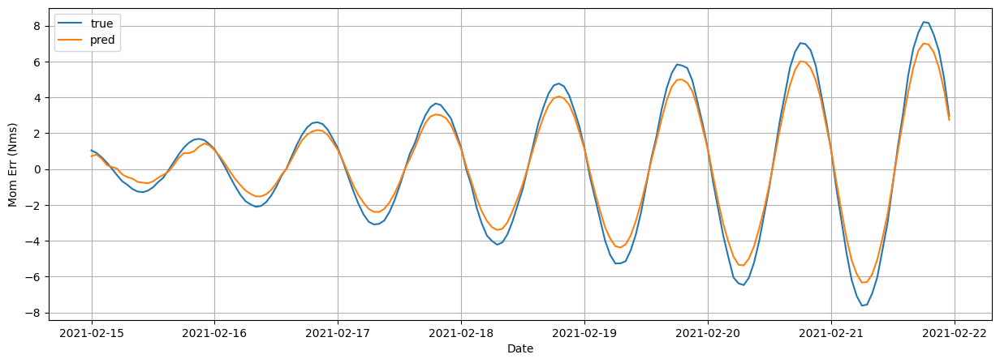

The root mean squared error is 0.6025107756208271.
The r2 score is 0.9717751606364379.
168
[2160.76442982]
[2160.76451847]
1/1 [==============================] - 0s 36ms/step
2021-02-14 00:00:00
2021-02-20 23:00:00
The first predicted value is  [0.6467242]
The first actual value is  [0.9741369]


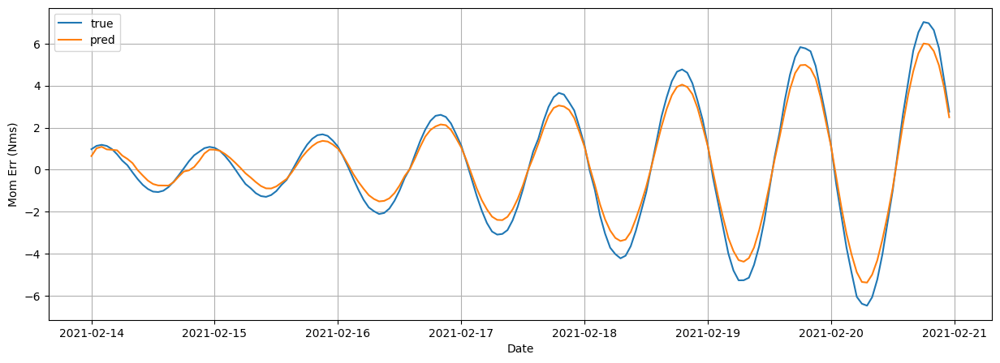

The root mean squared error is 0.5132448155314314.
The r2 score is 0.9687799768677242.
168
[1417.50699573]
[1417.50697125]
1/1 [==============================] - 0s 26ms/step
2021-02-13 00:00:00
2021-02-19 23:00:00
The first predicted value is  [0.5519731]
The first actual value is  [0.8615911]


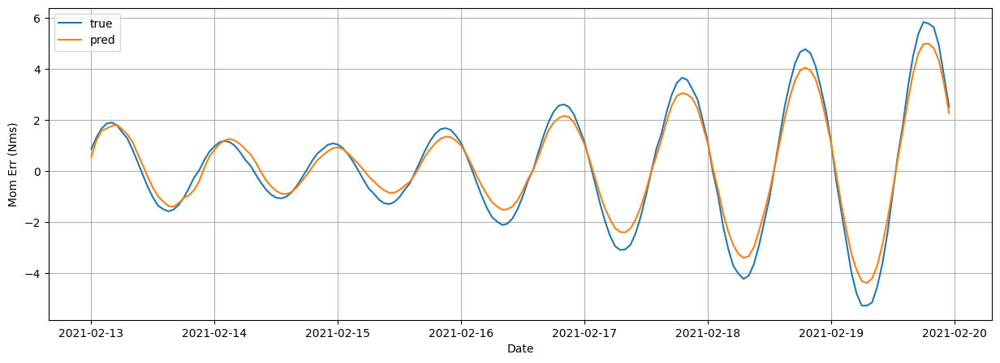

The root mean squared error is 0.4320687064347641.
The r2 score is 0.9651577033175964.
168
[900.13600131]
[900.13600296]
1/1 [==============================] - 0s 28ms/step
2021-02-12 00:00:00
2021-02-18 23:00:00
The first predicted value is  [0.38924918]
The first actual value is  [0.7498636]


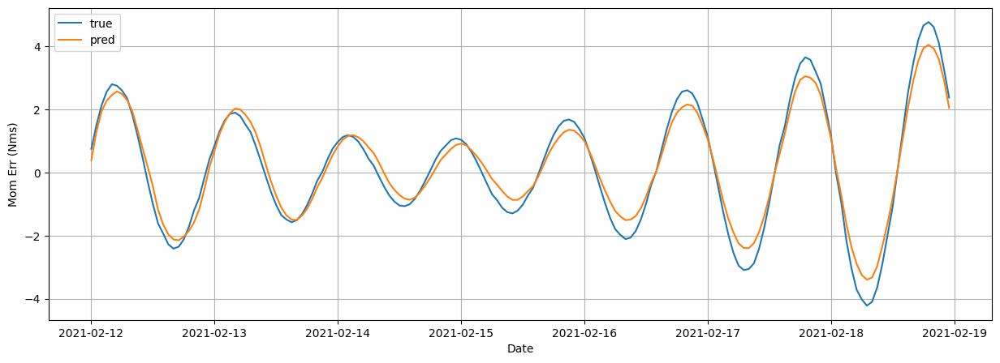

The root mean squared error is 0.37105921282761434.
The r2 score is 0.9614509913712886.
168
[600.04323693]
[600.04318259]
1/1 [==============================] - 0s 53ms/step
2021-02-01 00:00:00
2021-02-07 23:00:00
The first predicted value is  [0.6956815]
The first actual value is  [1.289471]


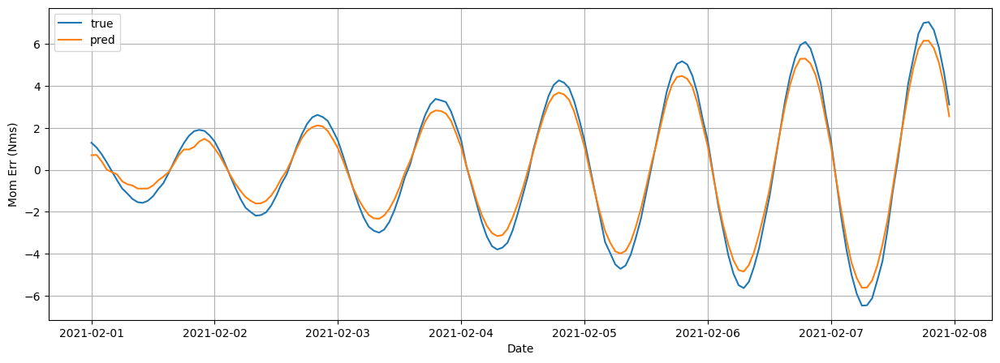

The root mean squared error is 0.4823847796913542.
The r2 score is 0.9766574663718475.
168
[1674.74408026]
[1674.74419601]
1/1 [==============================] - 0s 31ms/step
2021-01-31 00:00:00
2021-02-06 23:00:00
The first predicted value is  [0.6303073]
The first actual value is  [1.228656]


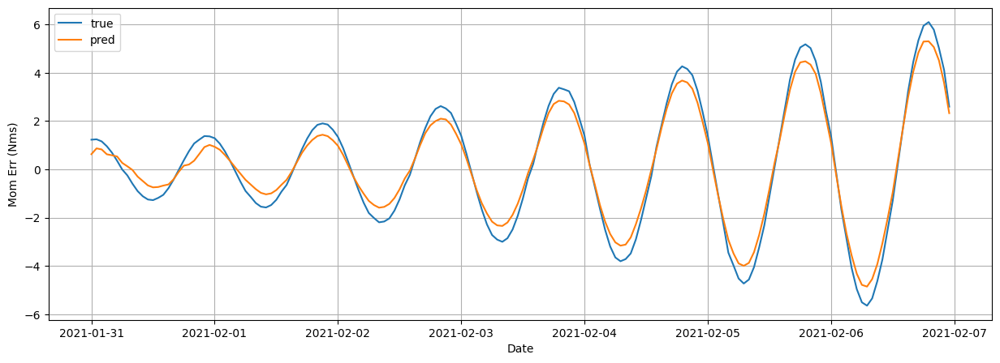

The root mean squared error is 0.44398752457523544.
The r2 score is 0.970895339293395.
168
[1137.85874231]
[1137.85854528]
1/1 [==============================] - 0s 39ms/step
2021-01-30 00:00:00
2021-02-05 23:00:00
The first predicted value is  [0.54287297]
The first actual value is  [1.162261]


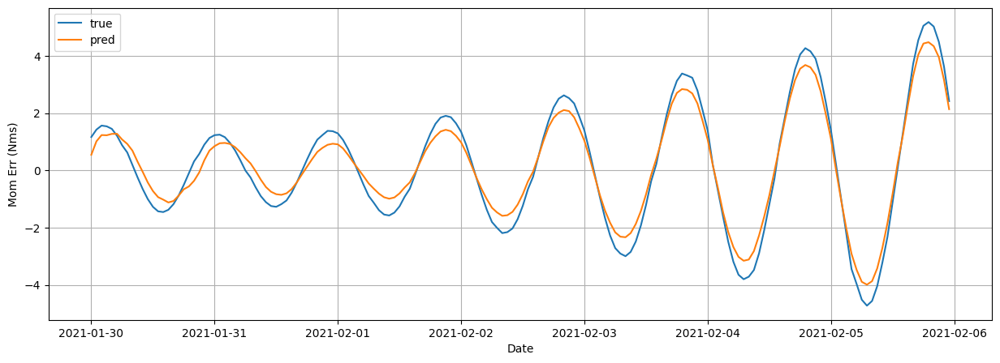

The root mean squared error is 0.42318190083514745.
The r2 score is 0.9604558624386843.
168
[760.81896112]
[760.81898901]
1/1 [==============================] - 0s 34ms/step
2021-01-18 00:00:00
2021-01-24 23:00:00
The first predicted value is  [0.653671]
The first actual value is  [0.8367424]


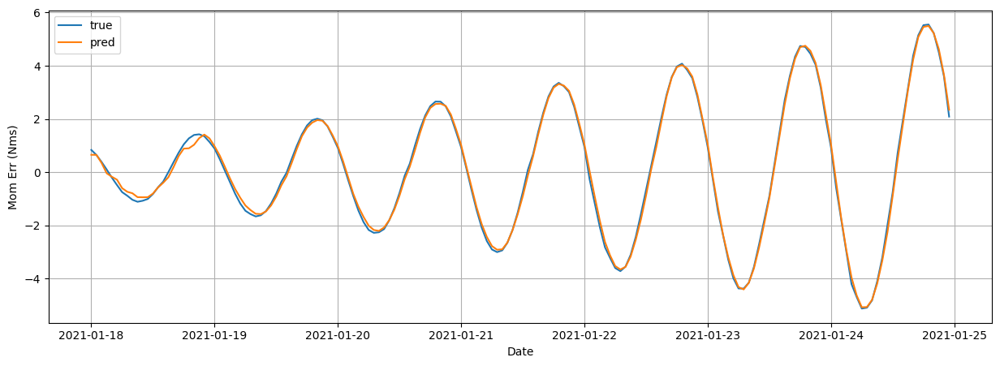

The root mean squared error is 0.1272472931396794.
The r2 score is 0.9973612089798533.
168
[1030.86391998]
[1030.86403809]
1/1 [==============================] - 0s 42ms/step
2021-01-17 00:00:00
2021-01-23 23:00:00
The first predicted value is  [0.5913783]
The first actual value is  [0.782022]


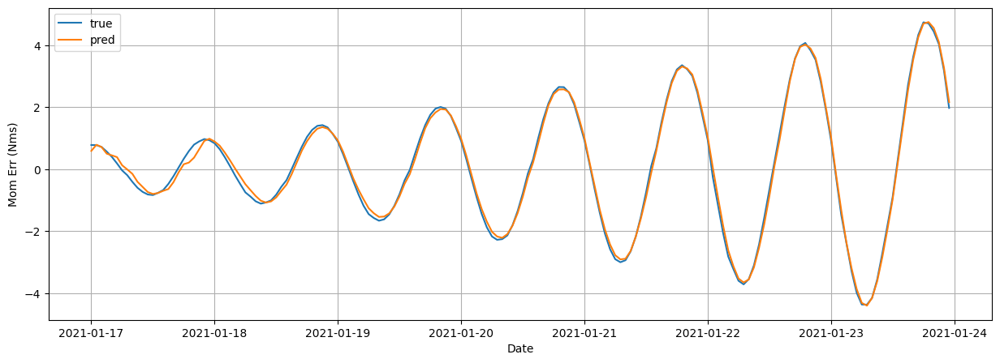

The root mean squared error is 0.1298685003974517.
The r2 score is 0.995919970255989.
168
[694.47020847]
[694.47018287]
1/1 [==============================] - 0s 45ms/step
2021-01-16 00:00:00
2021-01-22 23:00:00
The first predicted value is  [0.5093026]
The first actual value is  [0.7131546]


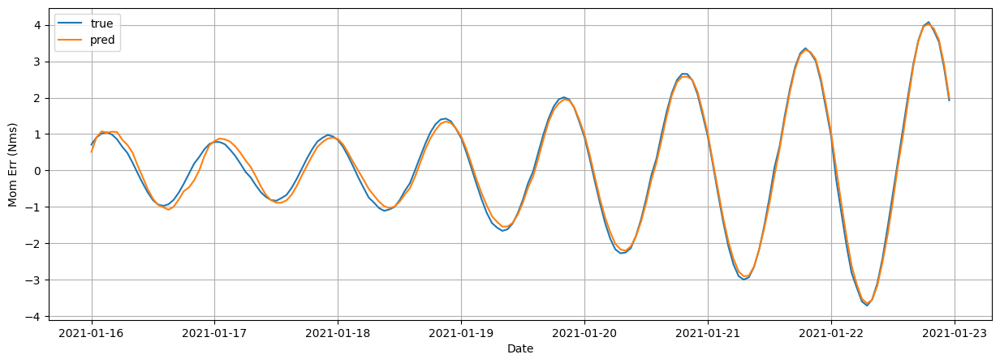

The root mean squared error is 0.14492085030510538.
The r2 score is 0.9922465216444083.
168
[455.06612582]
[455.06606422]
1/1 [==============================] - 0s 31ms/step
2021-01-15 00:00:00
2021-01-21 23:00:00
The first predicted value is  [0.36826256]
The first actual value is  [0.632556]


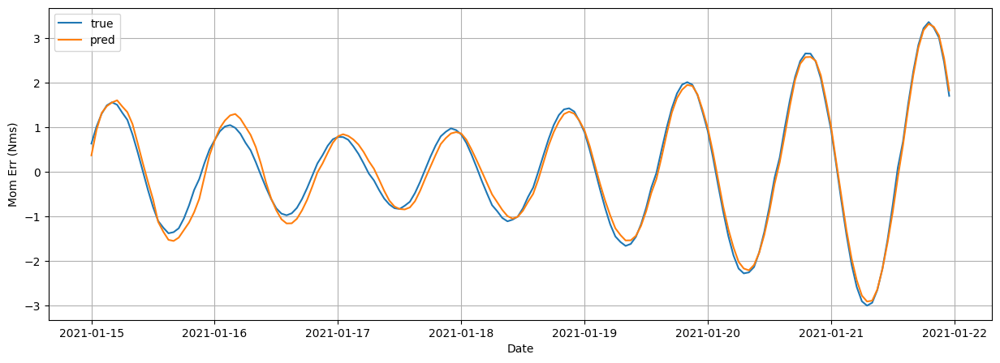

The root mean squared error is 0.16112753148540018.
The r2 score is 0.9854305632069736.
168
[299.36845325]
[299.36844763]
1/1 [==============================] - 0s 22ms/step
2021-01-04 00:00:00
2021-01-10 23:00:00
The first predicted value is  [0.6818869]
The first actual value is  [0.11077]


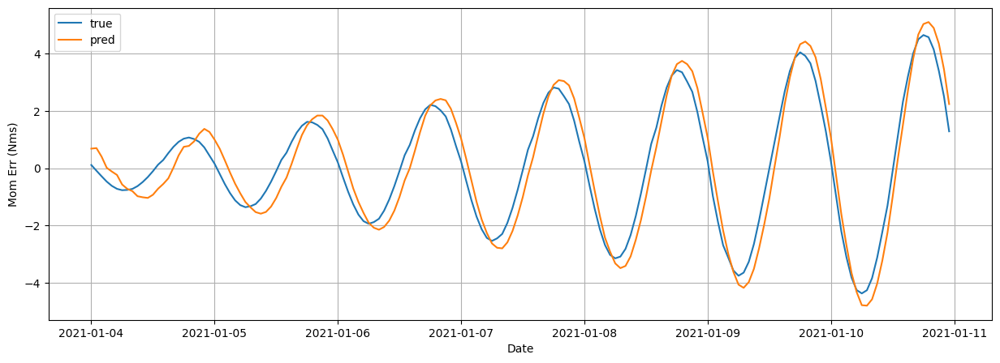

The root mean squared error is 0.6397474036255651.
The r2 score is 0.9064909236685791.
168
[735.31369327]
[735.31356626]
1/1 [==============================] - 0s 26ms/step
2021-01-03 00:00:00
2021-01-09 23:00:00
The first predicted value is  [0.6253504]
The first actual value is  [0.06397454]


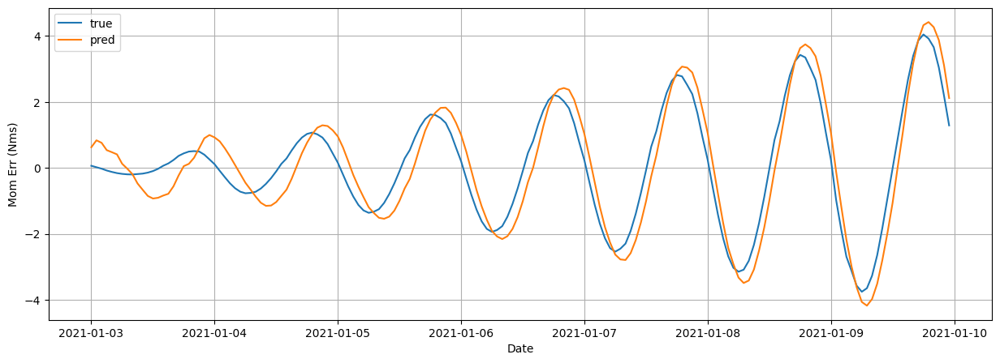

The root mean squared error is 0.635017815604166.
The r2 score is 0.8611282090614165.
168
[487.82841311]
[487.8283828]
1/1 [==============================] - 0s 22ms/step
2021-01-02 00:00:00
2021-01-08 23:00:00
The first predicted value is  [0.5502186]
The first actual value is  [-0.0010372]


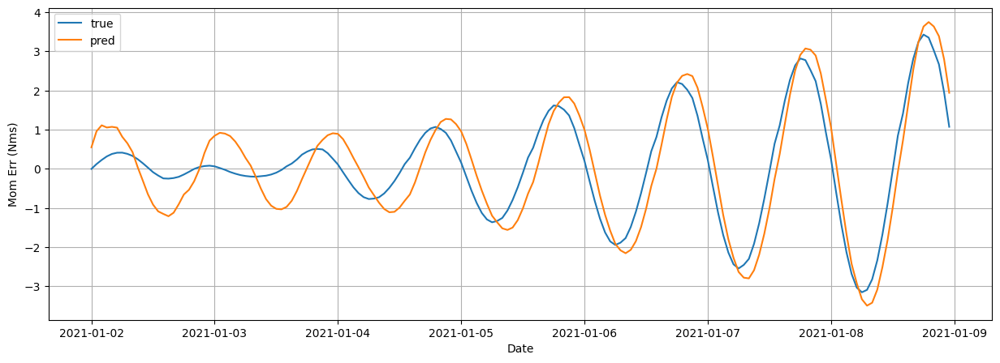

The root mean squared error is 0.6366531020063231.
The r2 score is 0.778188146019852.
168
[306.9943546]
[306.99425537]
1/1 [==============================] - 0s 31ms/step
2021-01-01 00:00:00
2021-01-07 23:00:00
The first predicted value is  [0.43881056]
The first actual value is  [-0.07571705]


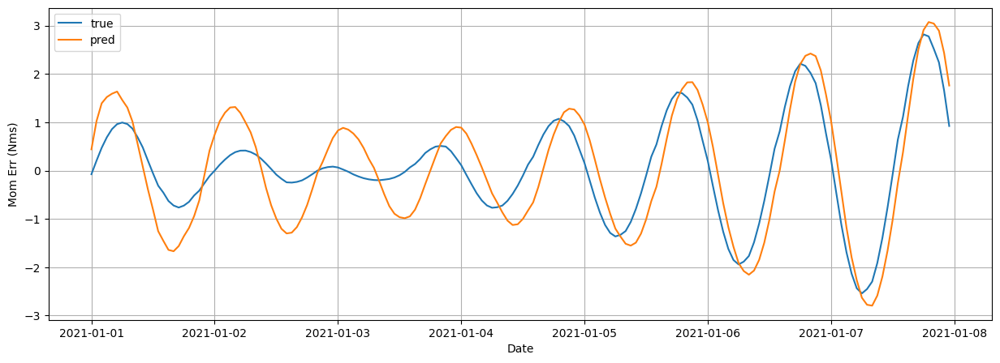

The root mean squared error is 0.650506443118072.
The r2 score is 0.6183813854423339.
168
[186.28718159]
[186.28716618]
1/1 [==============================] - 0s 30ms/step
2020-12-21 00:00:00
2020-12-27 23:00:00
The first predicted value is  [0.80878085]
The first actual value is  [0.7015915]


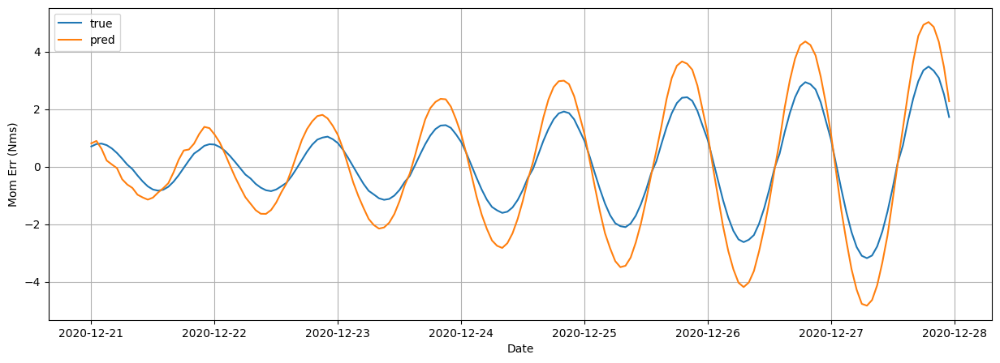

The root mean squared error is 0.864489196008117.
The r2 score is 0.6526530696532689.
168
[361.46394815]
[361.46392207]
1/1 [==============================] - 0s 25ms/step
2020-12-20 00:00:00
2020-12-26 23:00:00
The first predicted value is  [0.75967]
The first actual value is  [0.6331601]


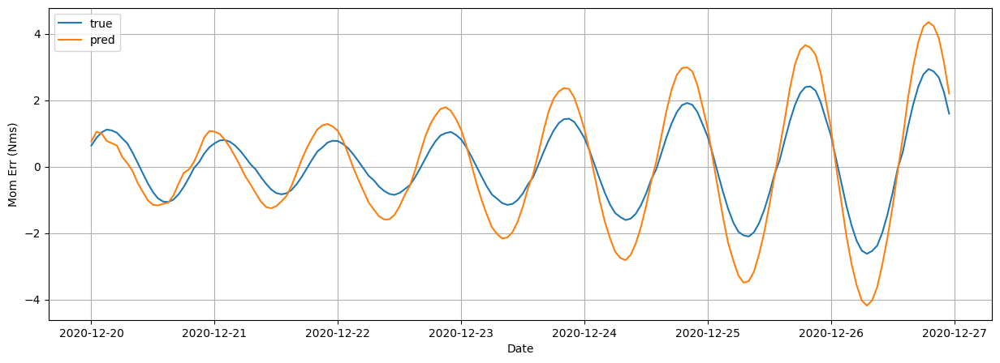

The root mean squared error is 0.7580717833507656.
The r2 score is 0.6020063577253986.
168
[242.57926711]
[242.57934039]
1/1 [==============================] - 0s 31ms/step
2020-12-19 00:00:00
2020-12-25 23:00:00
The first predicted value is  [0.69108254]
The first actual value is  [0.5436592]


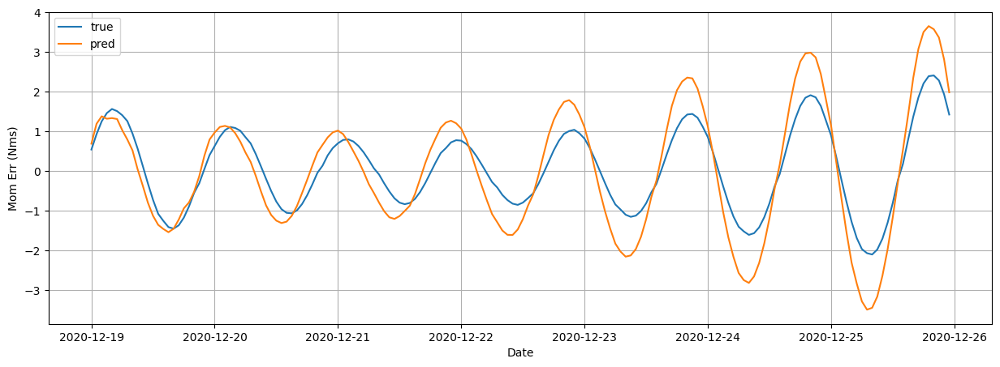

The root mean squared error is 0.6543230444545619.
The r2 score is 0.5918536862901976.
168
[176.22910625]
[176.22918595]
1/1 [==============================] - 0s 40ms/step
2020-12-18 00:00:00
2020-12-24 23:00:00
The first predicted value is  [0.60996133]
The first actual value is  [0.4477426]


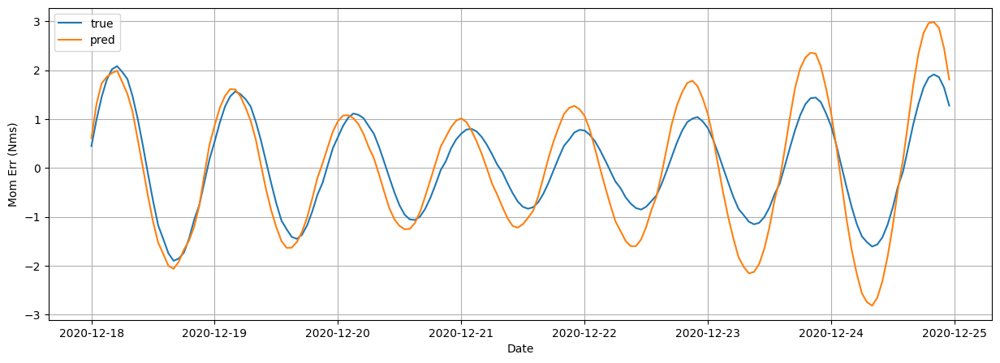

The root mean squared error is 0.5576079824229755.
The r2 score is 0.6767859445326356.
168
[161.61323356]
[161.61326633]
1/1 [==============================] - 0s 44ms/step
2020-12-07 00:00:00
2020-12-13 23:00:00
The first predicted value is  [1.0353457]
The first actual value is  [0.7030314]


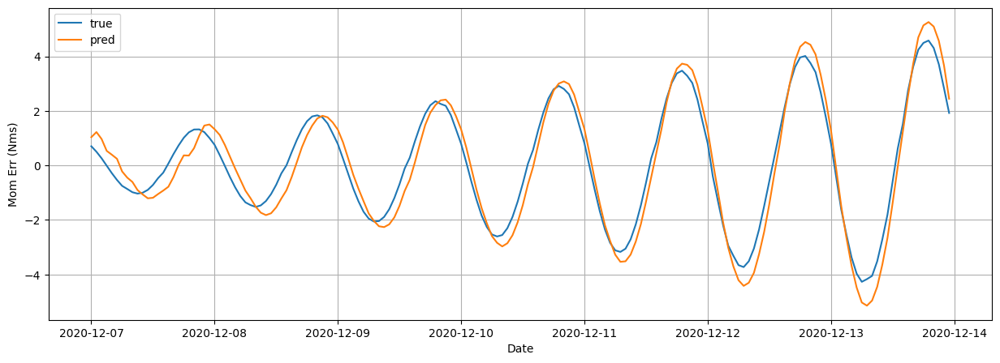

The root mean squared error is 0.5537996003286205.
The r2 score is 0.9312303501473402.
168
[749.23456426]
[749.23446114]
1/1 [==============================] - 0s 44ms/step
2020-12-06 00:00:00
2020-12-12 23:00:00
The first predicted value is  [0.99555737]
The first actual value is  [0.6616971]


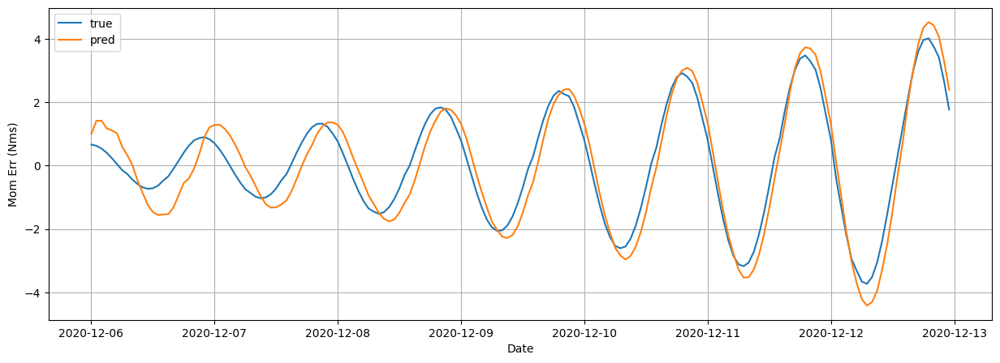

The root mean squared error is 0.5871537295844369.
The r2 score is 0.8882353240033901.
168
[518.21307382]
[518.21307446]
1/1 [==============================] - 0s 39ms/step
2020-12-05 00:00:00
2020-12-11 23:00:00
The first predicted value is  [0.9350658]
The first actual value is  [0.5986799]


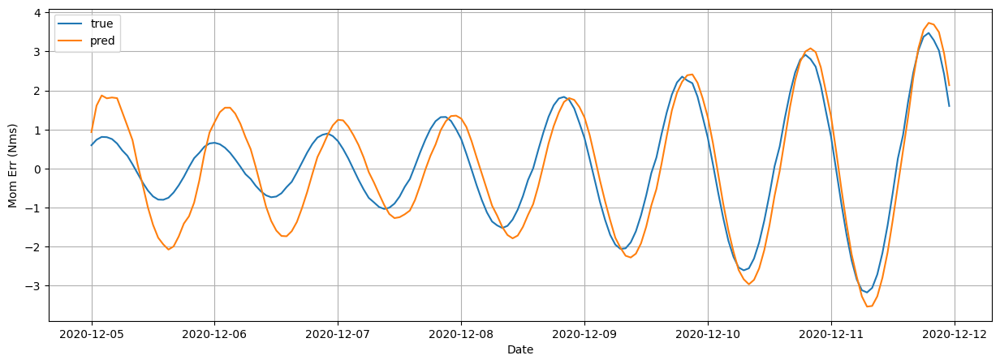

The root mean squared error is 0.6595342878140513.
The r2 score is 0.7889067044662221.
168
[346.18603295]
[346.18607814]
1/1 [==============================] - 0s 46ms/step
2020-12-04 00:00:00
2020-12-10 23:00:00
The first predicted value is  [0.86894876]
The first actual value is  [0.545976]


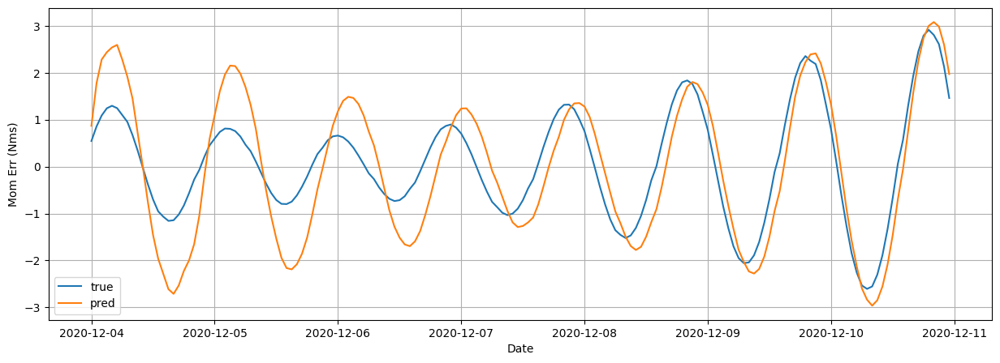

The root mean squared error is 0.7678553002445746.
The r2 score is 0.5718715730600118.
168
[231.36293633]
[231.3630439]
1/1 [==============================] - 0s 36ms/step
2020-11-23 00:00:00
2020-11-29 23:00:00
The first predicted value is  [1.2976428]
The first actual value is  [1.295931]


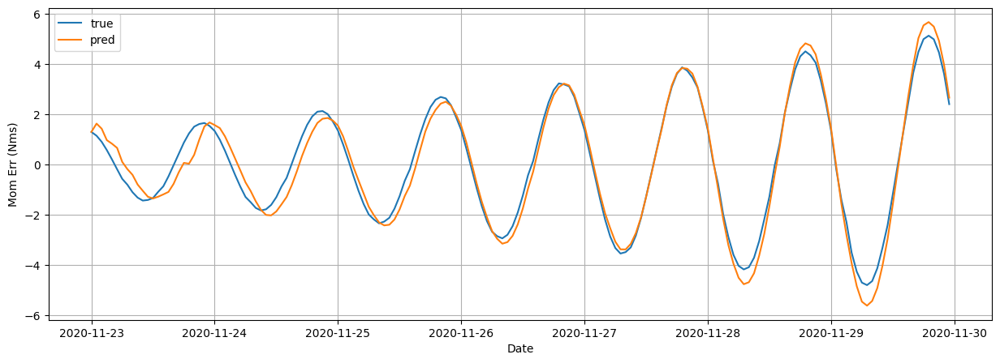

The root mean squared error is 0.43418837867722254.
The r2 score is 0.9666326857733674.
168
[949.17089304]
[949.17091255]
1/1 [==============================] - 0s 50ms/step
2020-11-22 00:00:00
2020-11-28 23:00:00
The first predicted value is  [1.2704434]
The first actual value is  [1.245343]


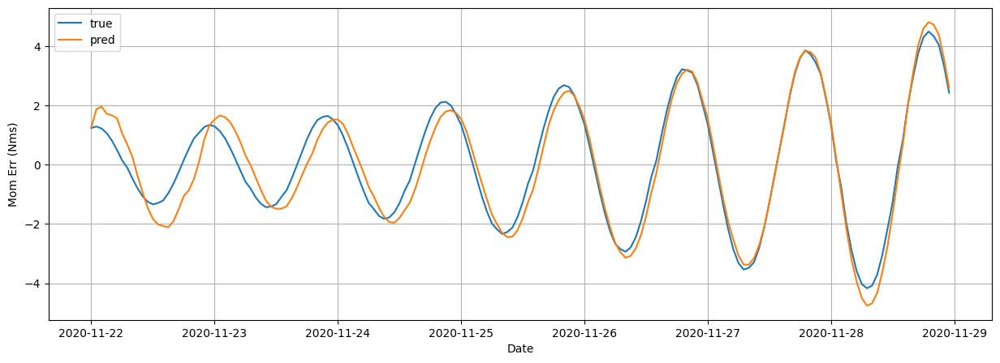

The root mean squared error is 0.5117619019888265.
The r2 score is 0.9348281082304075.
168
[675.12611075]
[675.1260375]
1/1 [==============================] - 0s 55ms/step
2020-11-21 00:00:00
2020-11-27 23:00:00
The first predicted value is  [1.2216557]
The first actual value is  [1.18102]


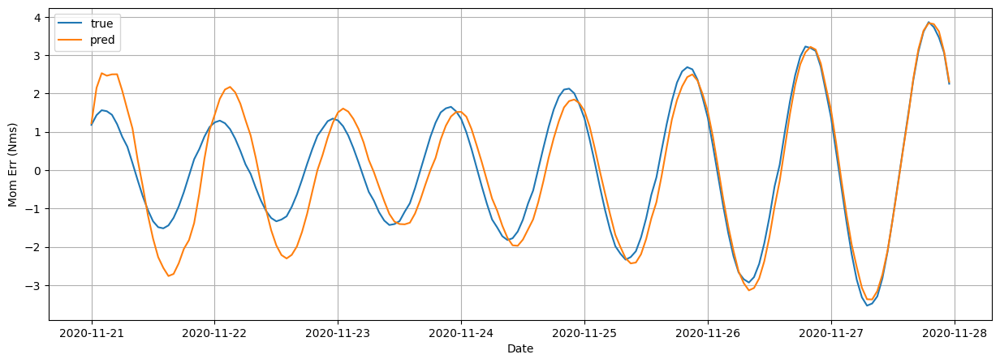

The root mean squared error is 0.6428808264221036.
The r2 score is 0.8544629621461698.
168
[477.08610814]
[477.08602701]
1/1 [==============================] - 0s 61ms/step
2020-11-20 00:00:00
2020-11-26 23:00:00
The first predicted value is  [1.1651537]
The first actual value is  [1.119641]


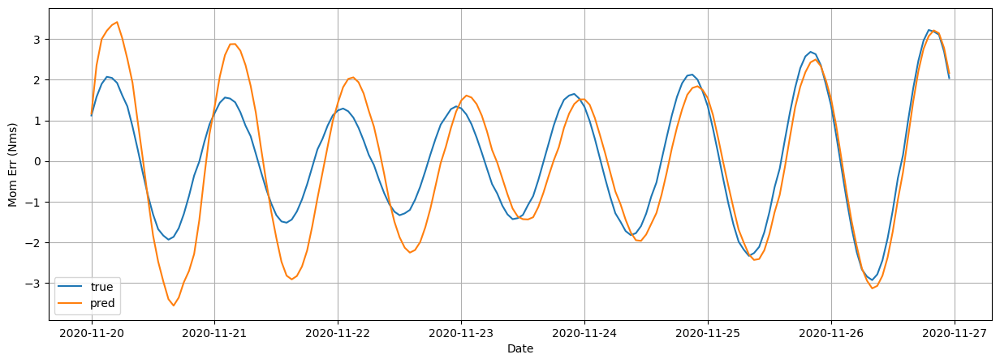

The root mean squared error is 0.7997810551437774.
The r2 score is 0.7020238979654643.
168
[360.63689008]
[360.63682605]
1/1 [==============================] - 0s 76ms/step
2020-11-09 00:00:00
2020-11-15 23:00:00
The first predicted value is  [1.4924508]
The first actual value is  [1.84101]


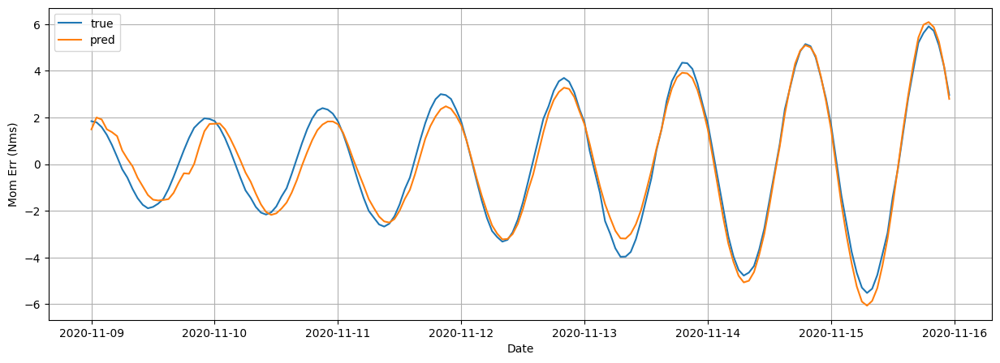

The root mean squared error is 0.4904111011706478.
The r2 score is 0.9672453647260206.
168
[1233.55106129]
[1233.55096924]
1/1 [==============================] - 0s 31ms/step
2020-11-08 00:00:00
2020-11-14 23:00:00
The first predicted value is  [1.4798967]
The first actual value is  [1.819208]


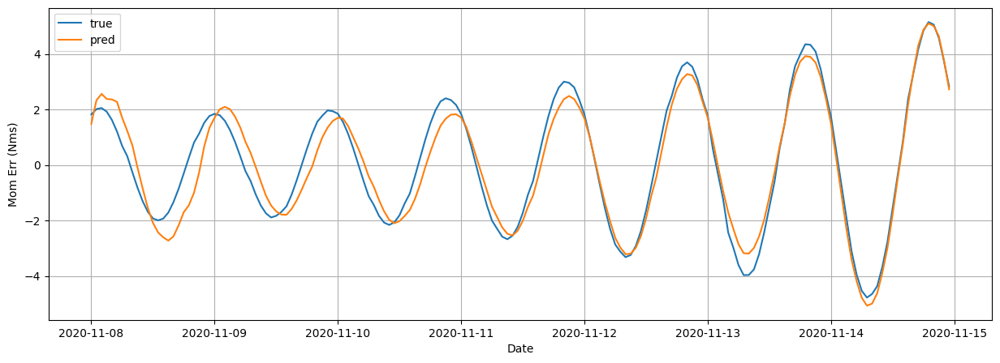

The root mean squared error is 0.5914065212753671.
The r2 score is 0.9345060291132519.
168
[897.18135125]
[897.18122656]
1/1 [==============================] - 0s 28ms/step
2020-11-07 00:00:00
2020-11-13 23:00:00
The first predicted value is  [1.444739]
The first actual value is  [1.778138]


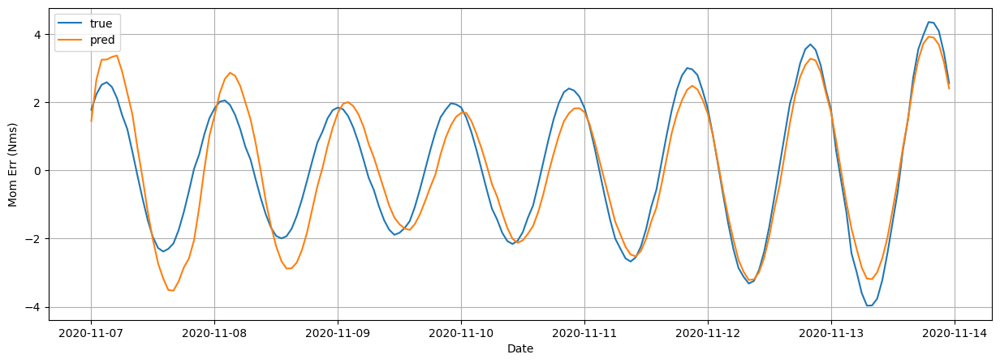

The root mean squared error is 0.7300232342399656.
The r2 score is 0.867642747701795.
168
[676.44874444]
[676.44875842]
1/1 [==============================] - 0s 29ms/step
2020-11-06 00:00:00
2020-11-12 23:00:00
The first predicted value is  [1.3972145]
The first actual value is  [1.717362]


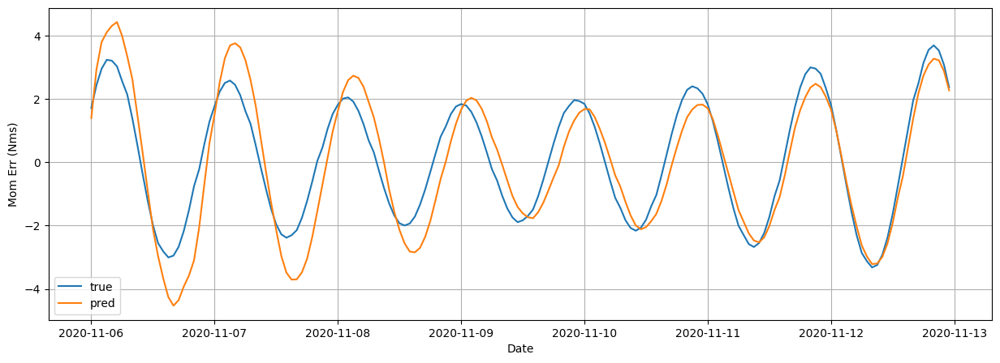

The root mean squared error is 0.8622159494142293.
The r2 score is 0.7859166874576173.
168
[583.38929325]
[583.38944877]
1/1 [==============================] - 0s 39ms/step
2020-10-26 00:00:00
2020-11-01 23:00:00
The first predicted value is  [1.5640466]
The first actual value is  [2.033866]


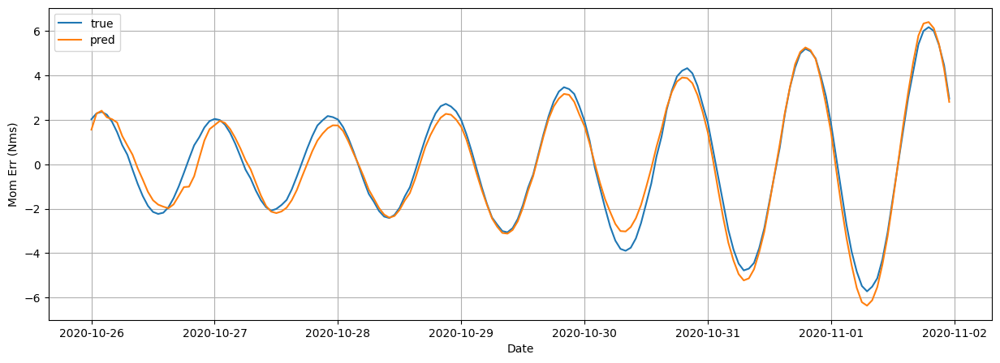

The root mean squared error is 0.42572339659272346.
The r2 score is 0.9757295315964788.
168
[1254.54465881]
[1254.54475958]
1/1 [==============================] - 0s 29ms/step
2020-10-25 00:00:00
2020-10-31 23:00:00
The first predicted value is  [1.5637374]
The first actual value is  [2.014047]


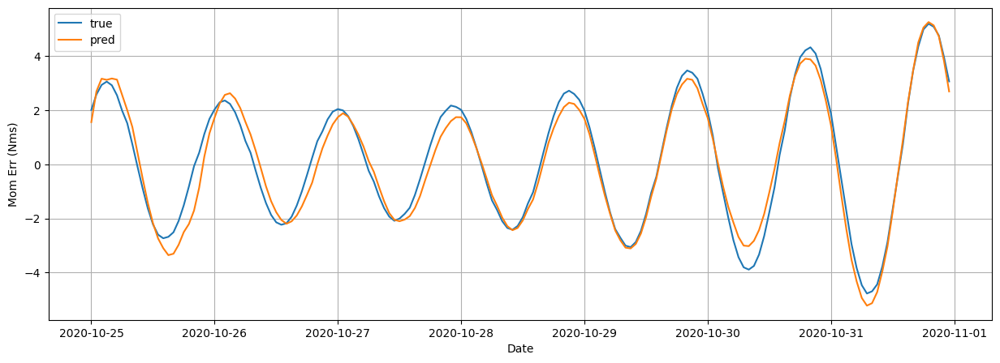

The root mean squared error is 0.4698726103792957.
The r2 score is 0.9599596874267956.
168
[926.34351325]
[926.34355163]
1/1 [==============================] - 0s 36ms/step
2020-10-24 00:00:00
2020-10-30 23:00:00
The first predicted value is  [1.5393]
The first actual value is  [1.970439]


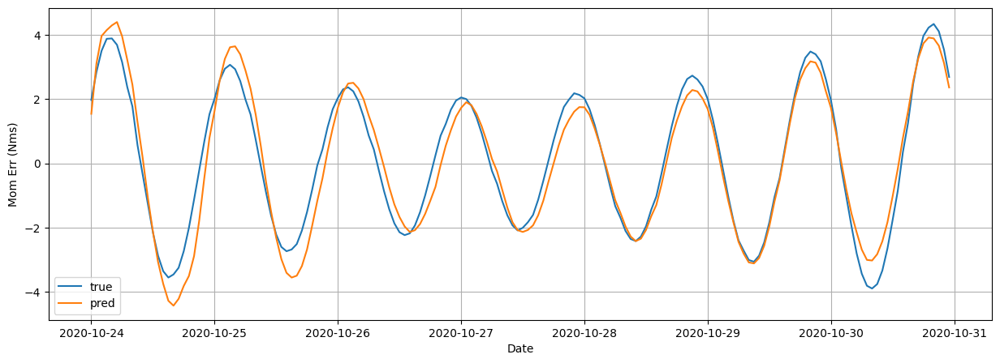

The root mean squared error is 0.5602470937568228.
The r2 score is 0.9329532340503712.
168
[786.48527128]
[786.48541315]
1/1 [==============================] - 0s 30ms/step
2020-10-23 00:00:00
2020-10-29 23:00:00
The first predicted value is  [1.4960911]
The first actual value is  [1.926718]


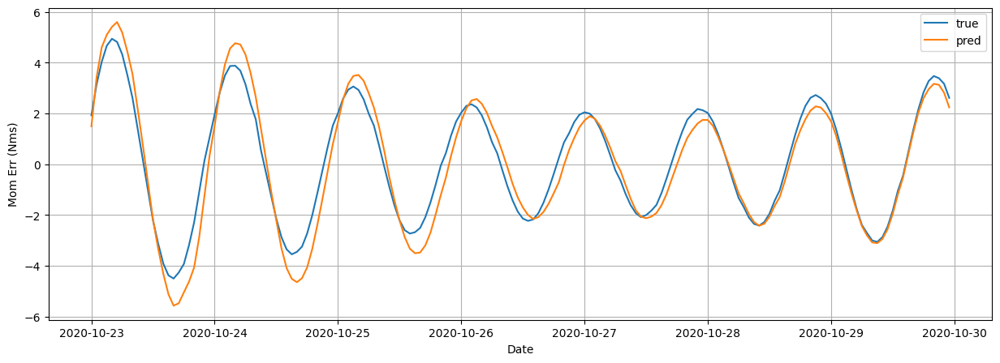

The root mean squared error is 0.6371508886465492.
The r2 score is 0.9192920368166374.
168
[845.04027577]
[845.0404165]
1/1 [==============================] - 0s 34ms/step
2020-10-12 00:00:00
2020-10-18 23:00:00
The first predicted value is  [1.4497948]
The first actual value is  [2.19894]


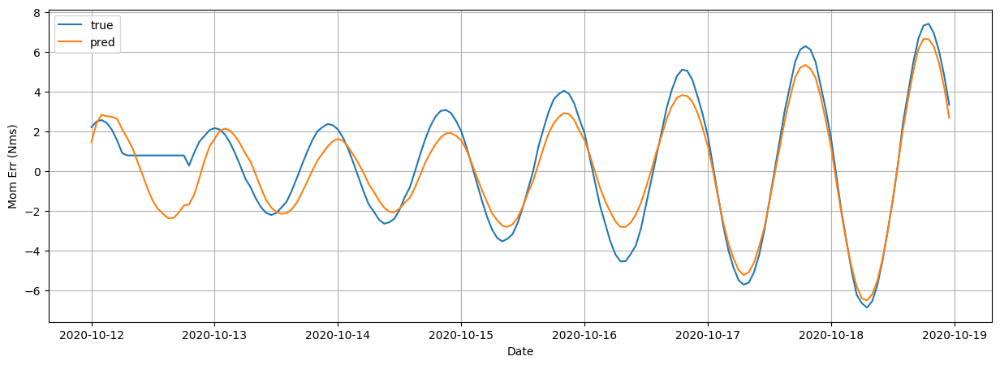

The root mean squared error is 1.017181003556095.
The r2 score is 0.8964800652049212.
168
[1679.11995079]
[1679.12015145]
1/1 [==============================] - 0s 33ms/step
2020-10-11 00:00:00
2020-10-17 23:00:00
The first predicted value is  [1.4578815]
The first actual value is  [2.219162]


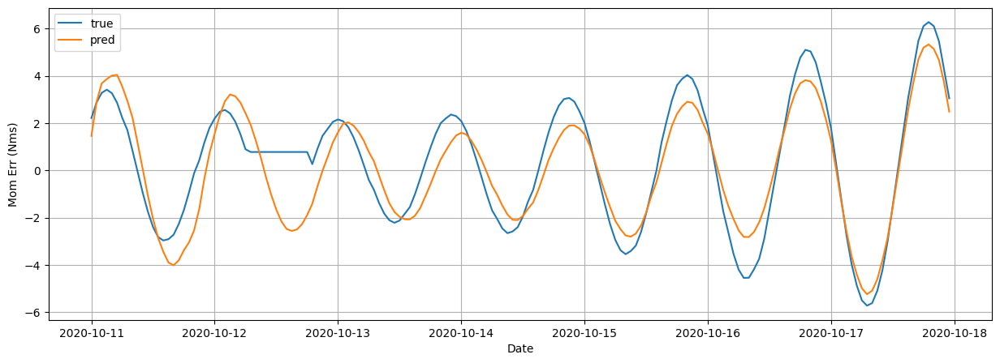

The root mean squared error is 1.1291367162697097.
The r2 score is 0.8202796681913815.
168
[1191.80477097]
[1191.80479738]
1/1 [==============================] - 0s 36ms/step
2020-10-10 00:00:00
2020-10-16 23:00:00
The first predicted value is  [1.4397578]
The first actual value is  [2.220534]


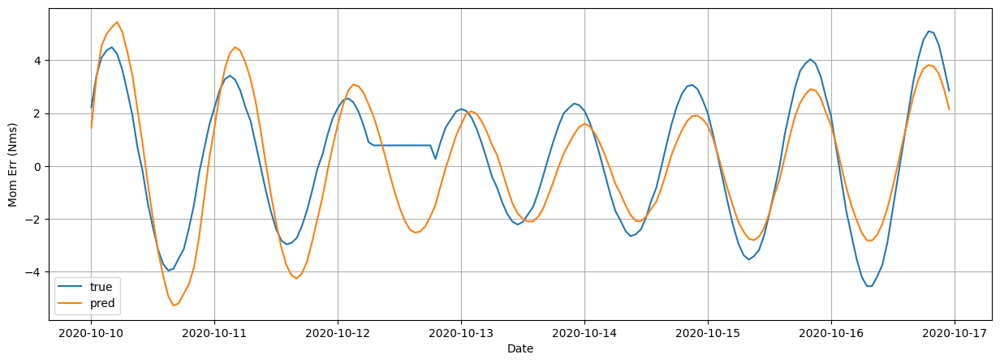

The root mean squared error is 1.2231802835429835.
The r2 score is 0.7408475957907821.
168
[969.91795732]
[969.91792063]
1/1 [==============================] - 0s 31ms/step
2020-10-09 00:00:00
2020-10-15 23:00:00
The first predicted value is  [1.397035]
The first actual value is  [2.201855]


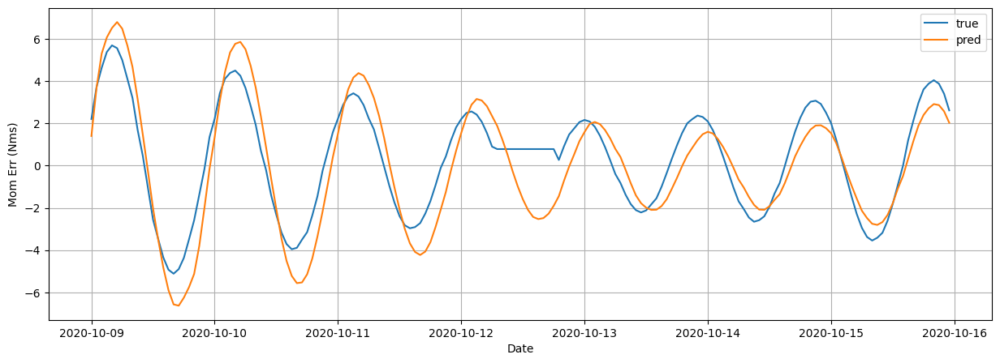

The root mean squared error is 1.2814946852060547.
The r2 score is 0.7332336562262882.
168
[1034.21746918]
[1034.21745651]
1/1 [==============================] - 0s 30ms/step
2020-09-28 00:00:00
2020-10-04 23:00:00
The first predicted value is  [1.1722057]
The first actual value is  [2.510866]


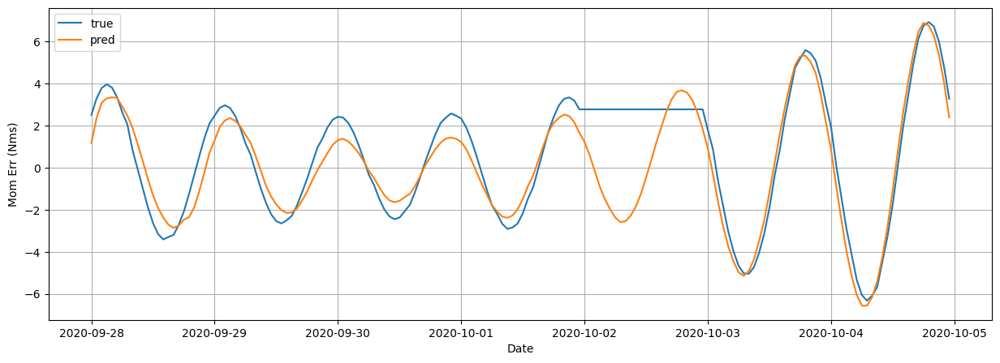

The root mean squared error is 1.3868267224548418.
The r2 score is 0.7755405244451884.
168
[1439.51333374]
[1439.5134951]
1/1 [==============================] - 0s 35ms/step
2020-09-27 00:00:00
2020-10-03 23:00:00
The first predicted value is  [1.1828133]
The first actual value is  [2.531778]


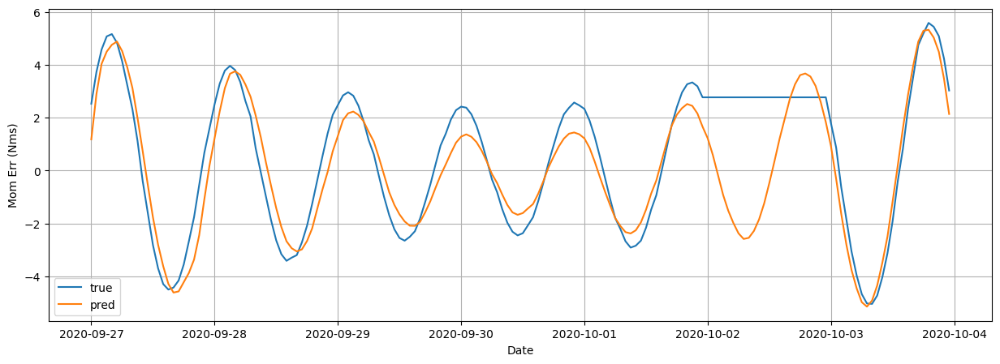

The root mean squared error is 1.4078514440864285.
The r2 score is 0.721123665794692.
168
[1194.01887244]
[1194.0191219]
1/1 [==============================] - 0s 29ms/step
2020-09-26 00:00:00
2020-10-02 23:00:00
The first predicted value is  [1.1657413]
The first actual value is  [2.520587]


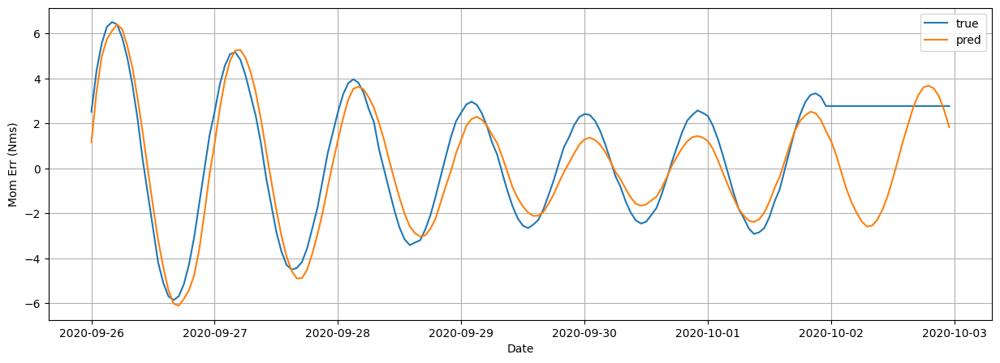

The root mean squared error is 1.441787241344935.
The r2 score is 0.734890348564086.
168
[1317.30394985]
[1317.3042686]
1/1 [==============================] - 0s 40ms/step
2020-09-25 00:00:00
2020-10-01 23:00:00
The first predicted value is  [1.1195799]
The first actual value is  [2.489124]


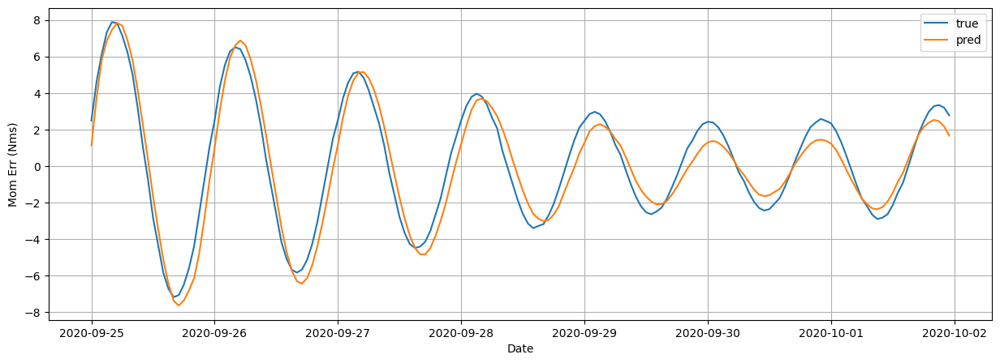

The root mean squared error is 0.9098292518245134.
The r2 score is 0.9253138671426584.
168
[1862.04080959]
[1862.04040316]
1/1 [==============================] - 0s 39ms/step
2020-09-14 00:00:00
2020-09-20 23:00:00
The first predicted value is  [0.78938067]
The first actual value is  [1.598318]


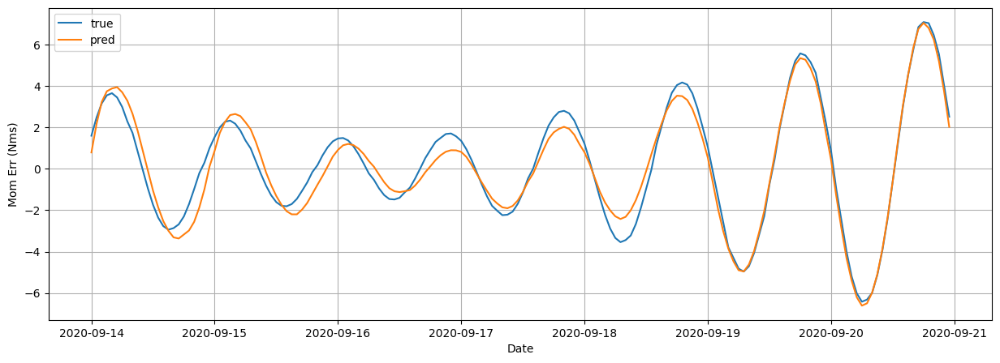

The root mean squared error is 0.5927222826669454.
The r2 score is 0.9559721014990424.
168
[1340.55252973]
[1340.5525211]
1/1 [==============================] - 0s 37ms/step
2020-09-13 00:00:00
2020-09-19 23:00:00
The first predicted value is  [0.79754645]
The first actual value is  [1.622379]


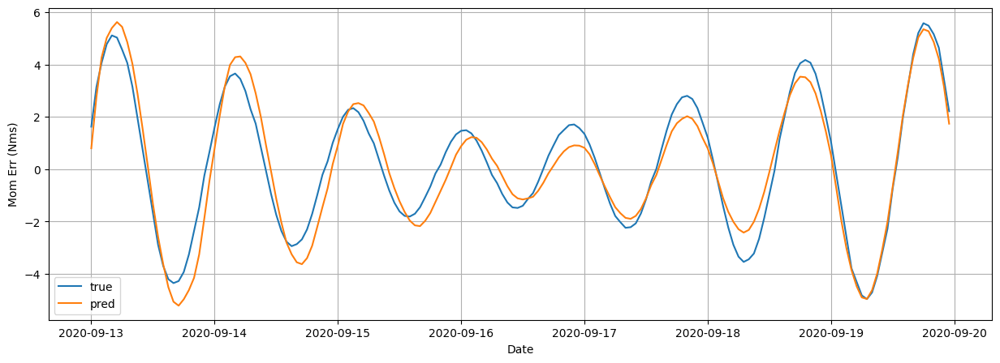

The root mean squared error is 0.6862159290332619.
The r2 score is 0.9248039758288437.
168
[1052.04892094]
[1052.04906088]
1/1 [==============================] - 0s 33ms/step
2020-09-12 00:00:00
2020-09-18 23:00:00
The first predicted value is  [0.7769903]
The first actual value is  [1.621165]


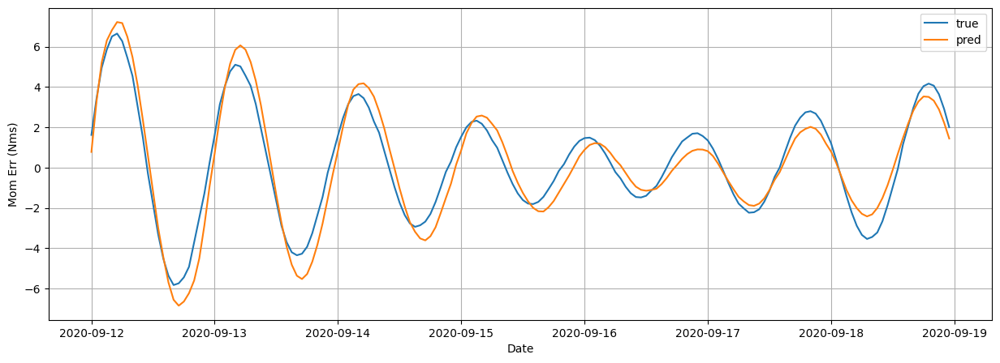

The root mean squared error is 0.786156528742435.
The r2 score is 0.9126195998687263.
168
[1188.26513688]
[1188.26499507]
1/1 [==============================] - 0s 30ms/step
2020-09-11 00:00:00
2020-09-17 23:00:00
The first predicted value is  [0.72257197]
The first actual value is  [1.589802]


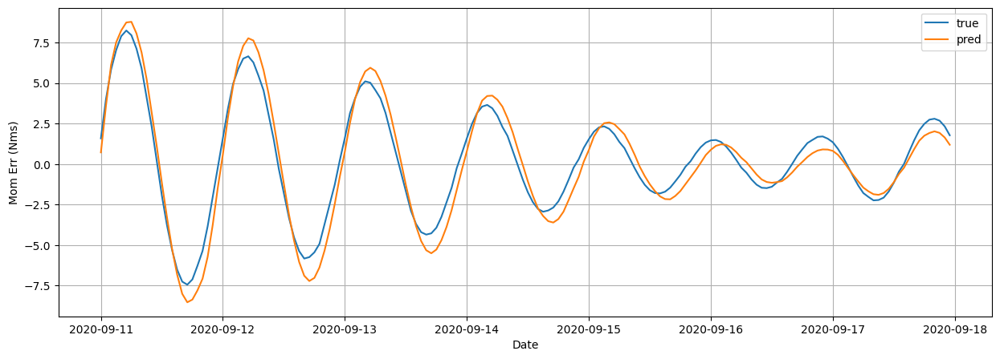

The root mean squared error is 0.8435990967752338.
The r2 score is 0.9316095098339201.
168
[1748.17831704]
[1748.17851095]
1/1 [==============================] - 0s 38ms/step
2020-09-01 00:00:00
2020-09-07 23:00:00
The first predicted value is  [0.3734606]
The first actual value is  [1.547121]


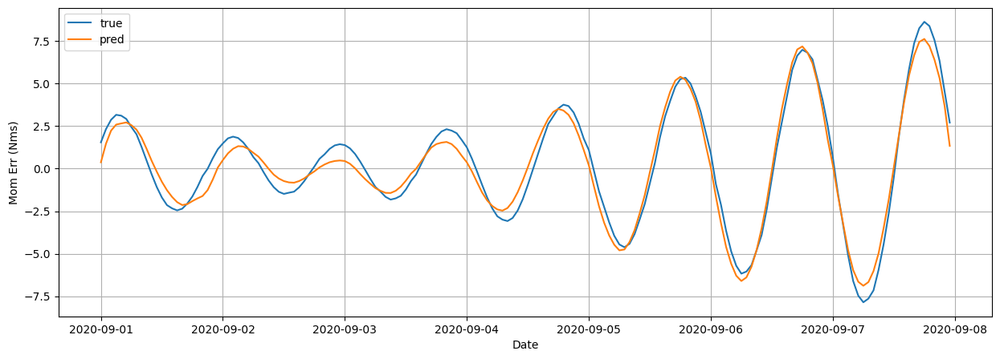

The root mean squared error is 0.665545880092613.
The r2 score is 0.9614010264564856.
168
[1927.92252487]
[1927.92229113]
1/1 [==============================] - 0s 33ms/step
2020-08-31 00:00:00
2020-09-06 23:00:00
The first predicted value is  [0.4063848]
The first actual value is  [1.583386]


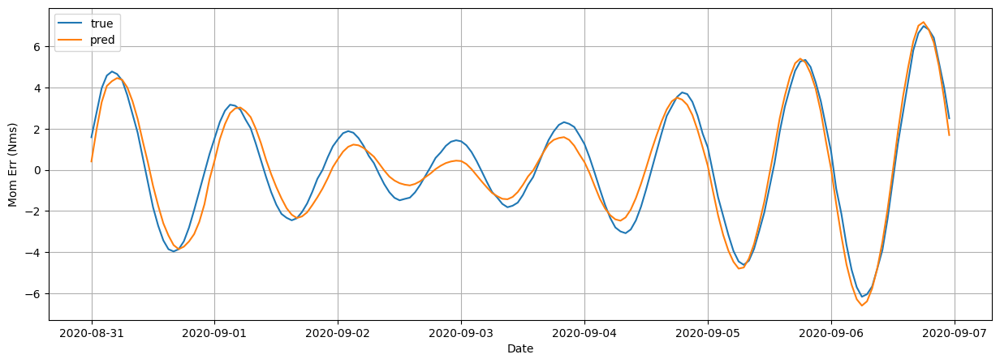

The root mean squared error is 0.6604785628046963.
The r2 score is 0.9452223987326933.
168
[1337.90048934]
[1337.90021592]
1/1 [==============================] - 0s 32ms/step
2020-08-30 00:00:00
2020-09-05 23:00:00
The first predicted value is  [0.40751603]
The first actual value is  [1.589177]


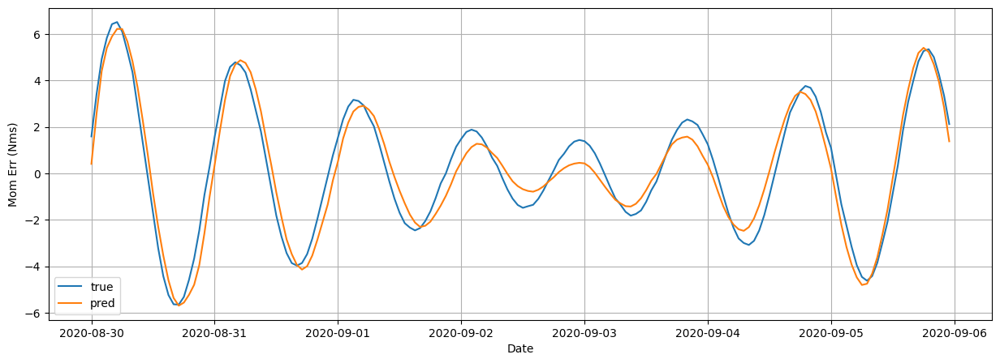

The root mean squared error is 0.6953948629877507.
The r2 score is 0.935675730667942.
168
[1262.98267083]
[1262.98262604]
1/1 [==============================] - 0s 39ms/step
2020-08-29 00:00:00
2020-09-04 23:00:00
The first predicted value is  [0.37904555]
The first actual value is  [1.573229]


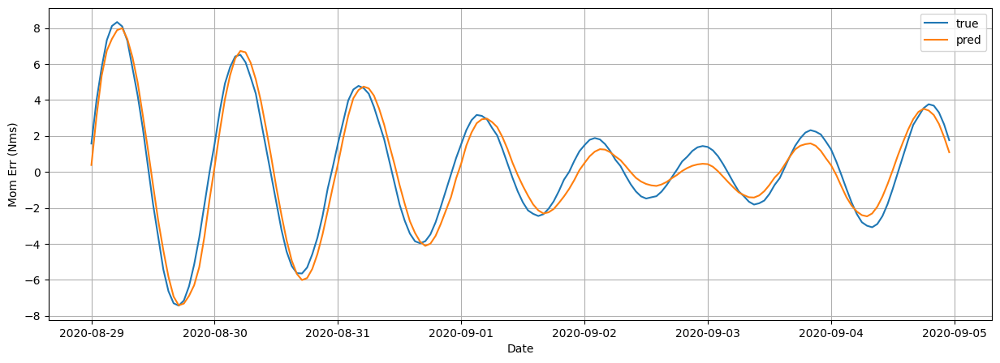

The root mean squared error is 0.7428422181300331.
The r2 score is 0.946180493530147.
168
[1722.51336029]
[1722.51386783]
1/1 [==============================] - 0s 31ms/step
2020-08-28 00:00:00
2020-09-03 23:00:00
The first predicted value is  [0.3126108]
The first actual value is  [1.515487]


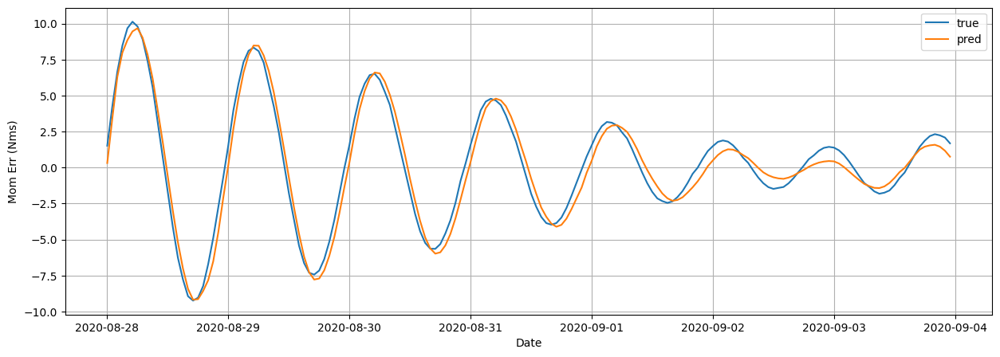

The root mean squared error is 0.7746147793338066.
The r2 score is 0.9626750183457307.
168
[2700.73076157]
[2700.73042239]
1/1 [==============================] - 0s 60ms/step
2020-08-18 00:00:00
2020-08-24 23:00:00
The first predicted value is  [0.1204575]
The first actual value is  [0.05249975]


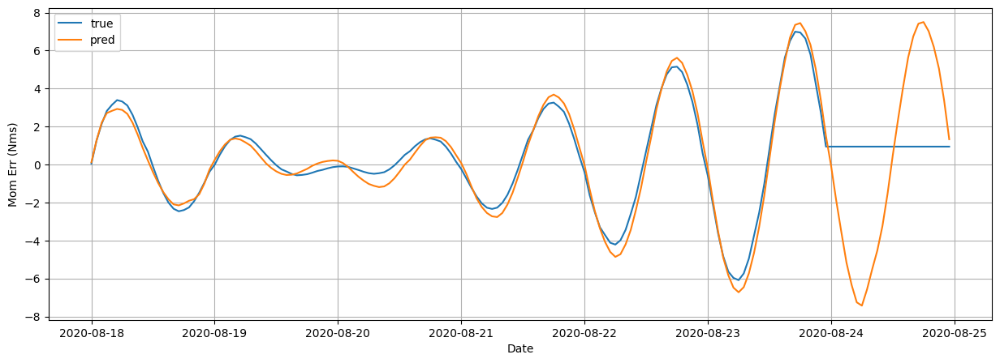

The root mean squared error is 2.0027895124386363.
The r2 score is 0.3382994120240532.
168
[1018.40016013]
[1018.39997104]
1/1 [==============================] - 0s 46ms/step
2020-08-17 00:00:00
2020-08-23 23:00:00
The first predicted value is  [0.14991808]
The first actual value is  [0.08051261]


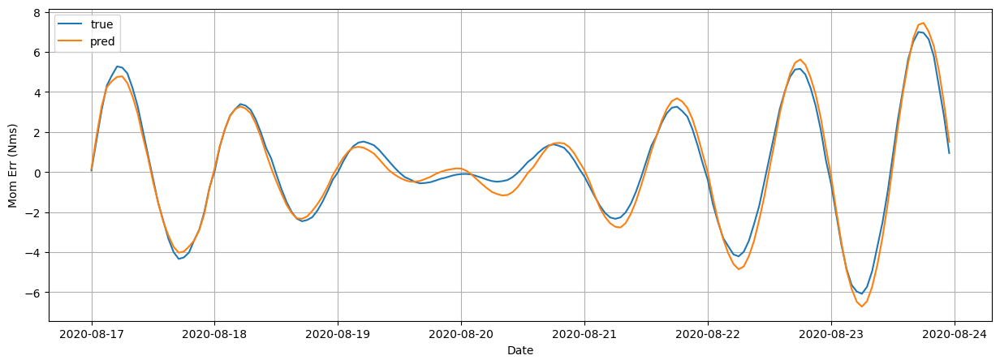

The root mean squared error is 0.3915466413555677.
The r2 score is 0.9800166743029216.
168
[1288.86835331]
[1288.86823677]
1/1 [==============================] - 0s 48ms/step
2020-08-16 00:00:00
2020-08-22 23:00:00
The first predicted value is  [0.14429332]
The first actual value is  [0.08492243]


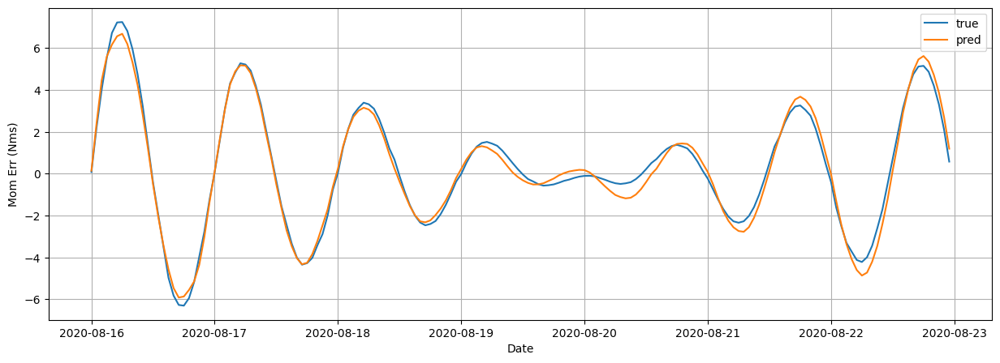

The root mean squared error is 0.35929875392433624.
The r2 score is 0.983602993009247.
168
[1322.68351087]
[1322.68406669]
1/1 [==============================] - 0s 89ms/step
2020-08-15 00:00:00
2020-08-21 23:00:00
The first predicted value is  [0.1082567]
The first actual value is  [0.05132911]


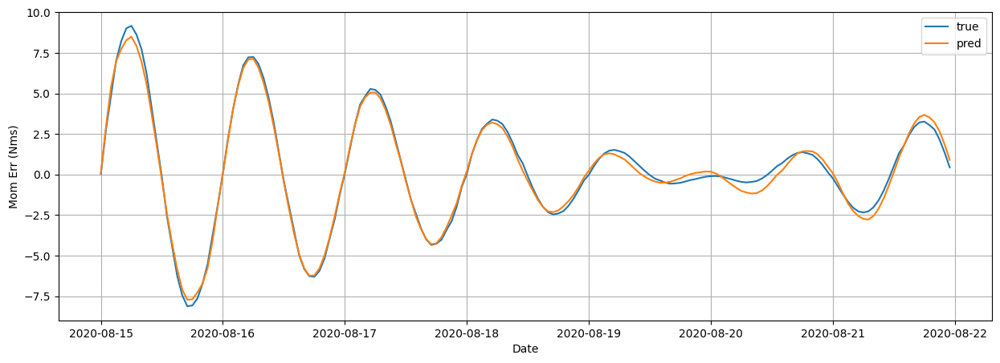

The root mean squared error is 0.3137816246298108.
The r2 score is 0.9915739059527283.
168
[1963.0795235]
[1963.07998032]
1/1 [==============================] - 0s 47ms/step
2020-08-14 00:00:00
2020-08-20 23:00:00
The first predicted value is  [0.03121713]
The first actual value is  [-0.01975701]


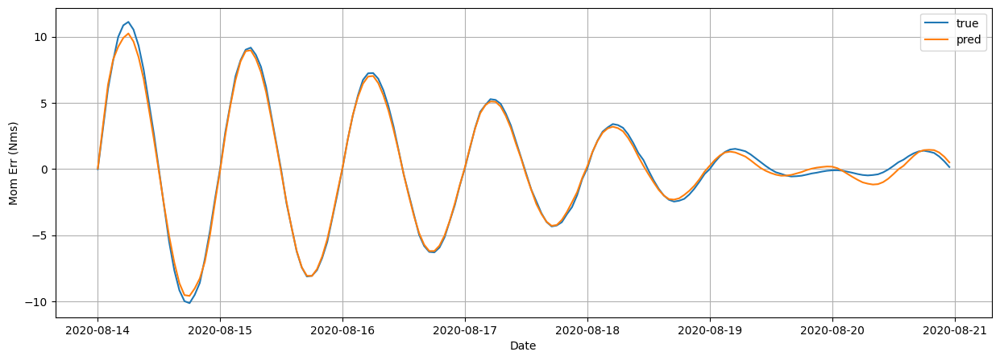

The root mean squared error is 0.3157050914218205.
The r2 score is 0.994811342069622.
168
[3227.13880776]
[3227.13707911]
1/1 [==============================] - 0s 34ms/step
2020-08-04 00:00:00
2020-08-10 23:00:00
The first predicted value is  [0.03874189]
The first actual value is  [0.06607191]


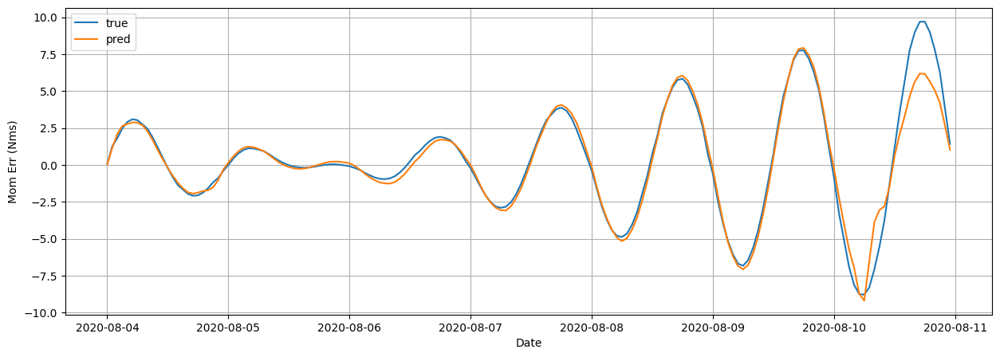

The root mean squared error is 0.8172962234296091.
The r2 score is 0.9506410082046678.
168
[2273.53681636]
[2273.53678724]
1/1 [==============================] - 0s 33ms/step
2020-08-03 00:00:00
2020-08-09 23:00:00
The first predicted value is  [0.06853811]
The first actual value is  [0.08242029]


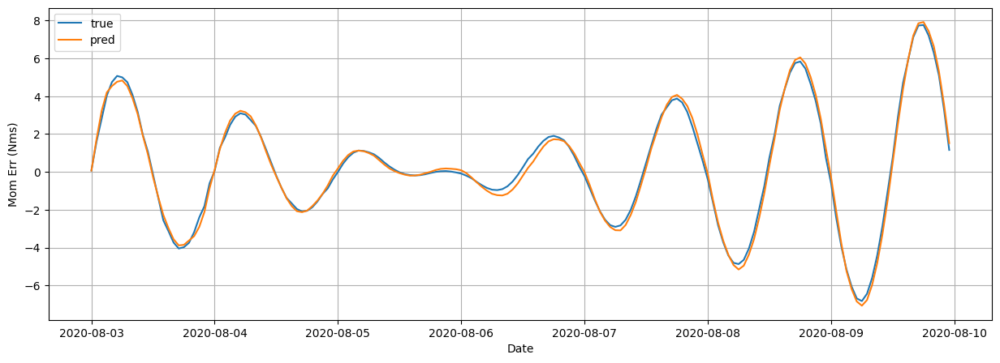

The root mean squared error is 0.22885530011062166.
The r2 score is 0.9940677312608269.
168
[1483.23636201]
[1483.23653499]
1/1 [==============================] - 0s 46ms/step
2020-08-02 00:00:00
2020-08-08 23:00:00
The first predicted value is  [0.06124825]
The first actual value is  [0.06472391]


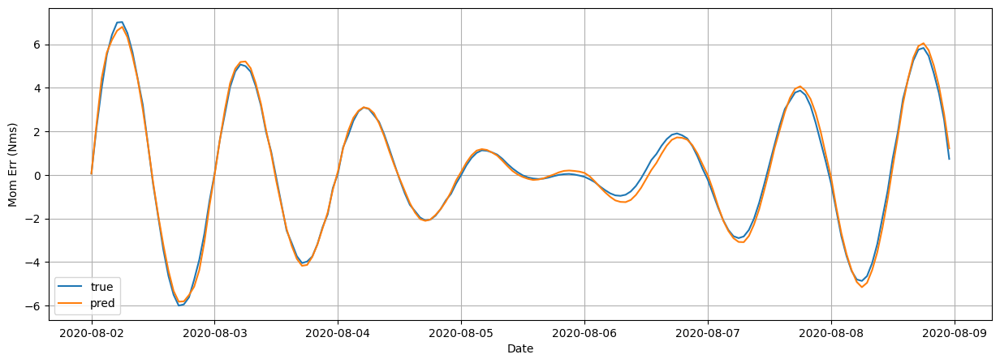

The root mean squared error is 0.20713259155768782.
The r2 score is 0.9946787041219465.
168
[1354.53071649]
[1354.53038634]
1/1 [==============================] - 0s 44ms/step
2020-08-01 00:00:00
2020-08-07 23:00:00
The first predicted value is  [0.02288769]
The first actual value is  [0.02111034]


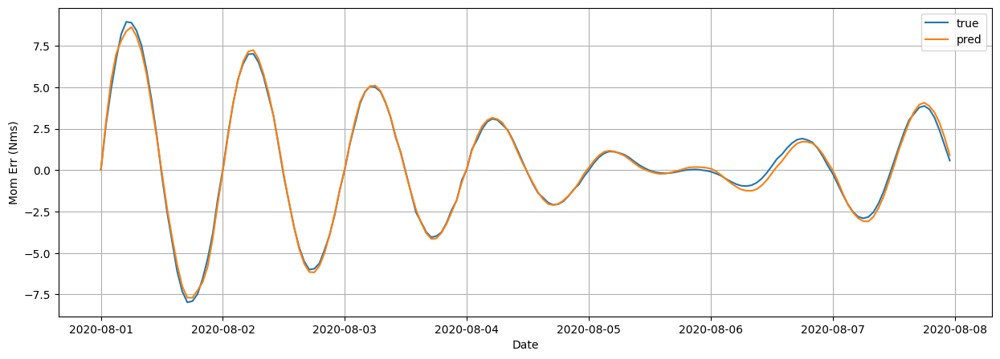

The root mean squared error is 0.1993752953649772.
The r2 score is 0.996454636301202.
168
[1883.61028424]
[1883.61081651]
1/1 [==============================] - 0s 51ms/step
2020-07-31 00:00:00
2020-08-06 23:00:00
The first predicted value is  [-0.04853188]
The first actual value is  [-0.05334451]


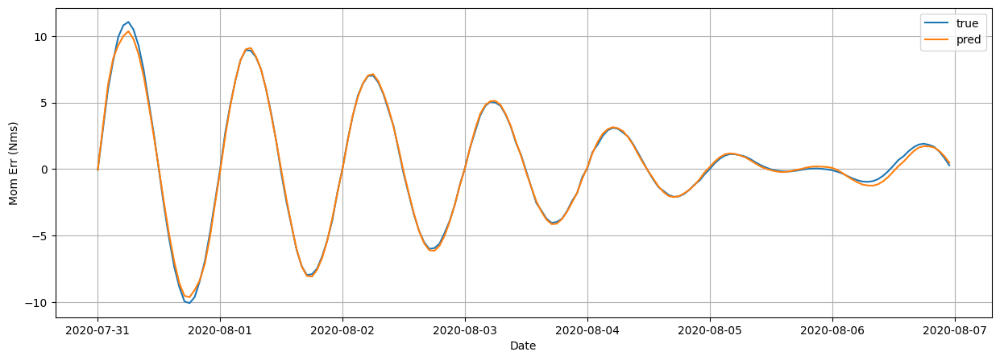

The root mean squared error is 0.20834389251123916.
The r2 score is 0.997637709853471.
168
[3087.00637896]
[3087.00683469]
1/1 [==============================] - 0s 59ms/step
2020-07-21 00:00:00
2020-07-27 23:00:00
The first predicted value is  [0.09667028]
The first actual value is  [-0.6000504]


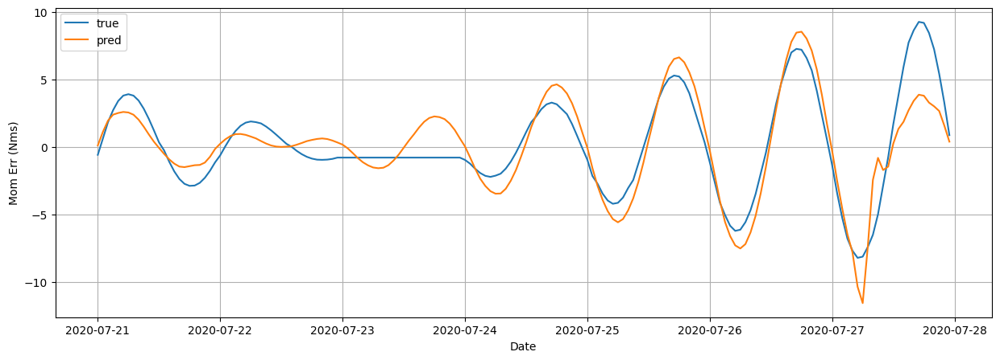

The root mean squared error is 1.651339395926607.
The r2 score is 0.7753995016259111.
168
[2039.72306456]
[2039.72326779]
1/1 [==============================] - 0s 34ms/step
2020-07-20 00:00:00
2020-07-26 23:00:00
The first predicted value is  [0.13196214]
The first actual value is  [-0.5929515]


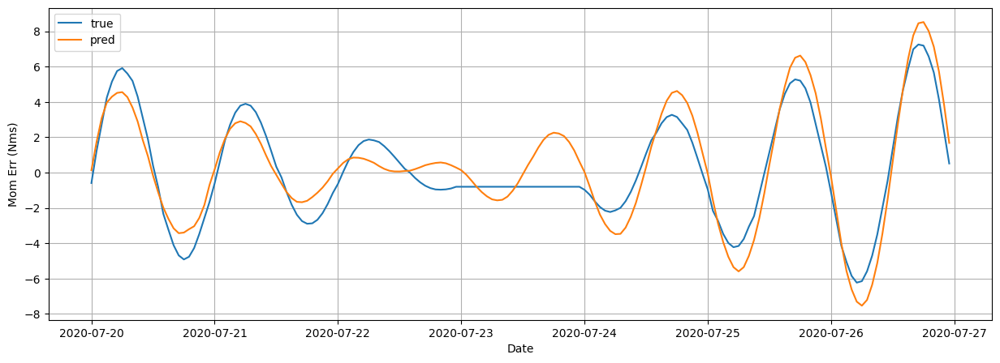

The root mean squared error is 1.1857883457611311.
The r2 score is 0.8383265718852652.
168
[1461.11686642]
[1461.11698696]
1/1 [==============================] - 0s 33ms/step
2020-07-19 00:00:00
2020-07-25 23:00:00
The first predicted value is  [0.12806654]
The first actual value is  [-0.6236781]


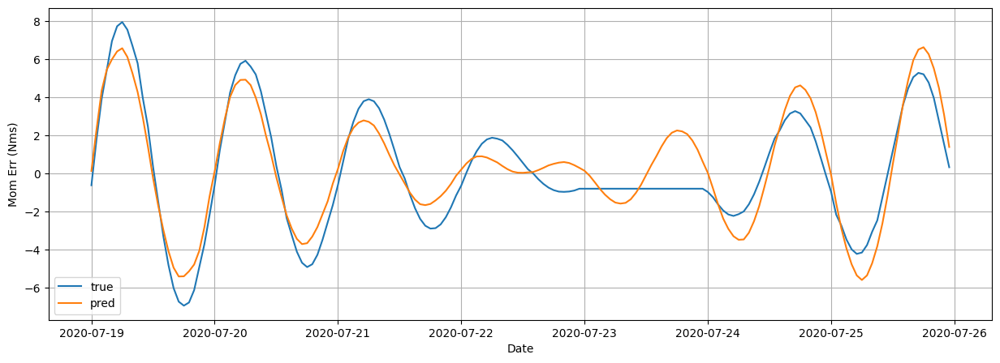

The root mean squared error is 1.1647358810062896.
The r2 score is 0.8556662771849329.
168
[1579.05211441]
[1579.05180117]
1/1 [==============================] - 0s 39ms/step
2020-07-18 00:00:00
2020-07-24 23:00:00
The first predicted value is  [0.09259571]
The first actual value is  [-0.6813693]


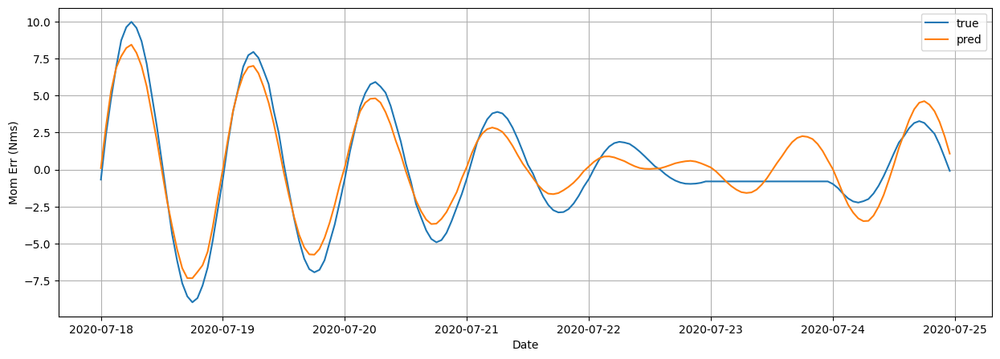

The root mean squared error is 1.1471339016837208.
The r2 score is 0.907305439839987.
168
[2384.9713289]
[2384.97188258]
1/1 [==============================] - 0s 37ms/step
2020-07-17 00:00:00
2020-07-23 23:00:00
The first predicted value is  [0.05352799]
The first actual value is  [-0.7849885]


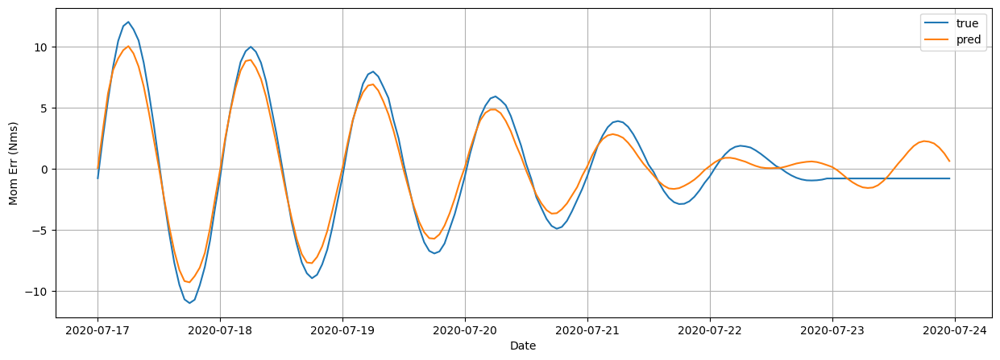

The root mean squared error is 1.1625311301316954.
The r2 score is 0.9416300094319789.
168
[3889.81520829]
[3889.81405312]
1/1 [==============================] - 0s 34ms/step
2020-07-07 00:00:00
2020-07-13 23:00:00
The first predicted value is  [0.24371932]
The first actual value is  [-0.4731298]


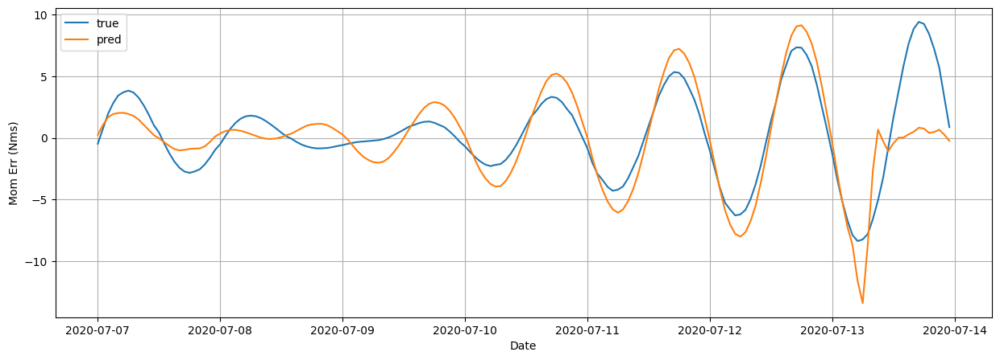

The root mean squared error is 2.220481833005375.
The r2 score is 0.5982723905258321.
168
[2061.92118566]
[2061.92113348]
1/1 [==============================] - 0s 30ms/step
2020-07-06 00:00:00
2020-07-12 23:00:00
The first predicted value is  [0.28720805]
The first actual value is  [-0.4722565]


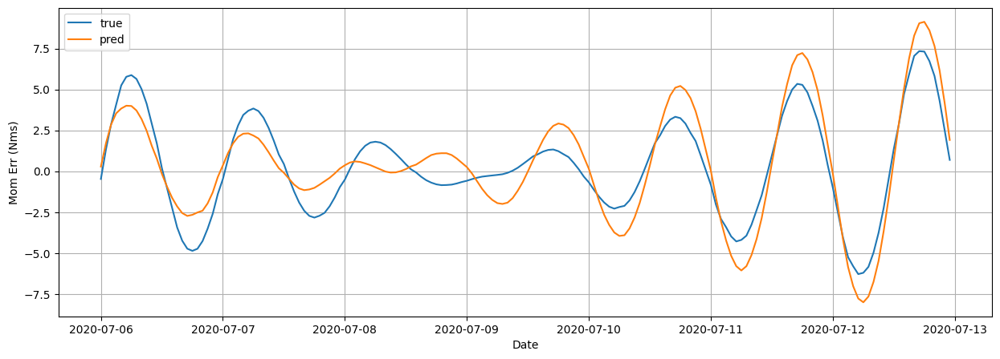

The root mean squared error is 1.3581066681323792.
The r2 score is 0.7876309576323546.
168
[1459.10263913]
[1459.10261611]
1/1 [==============================] - 0s 30ms/step
2020-07-05 00:00:00
2020-07-11 23:00:00
The first predicted value is  [0.28953266]
The first actual value is  [-0.5133804]


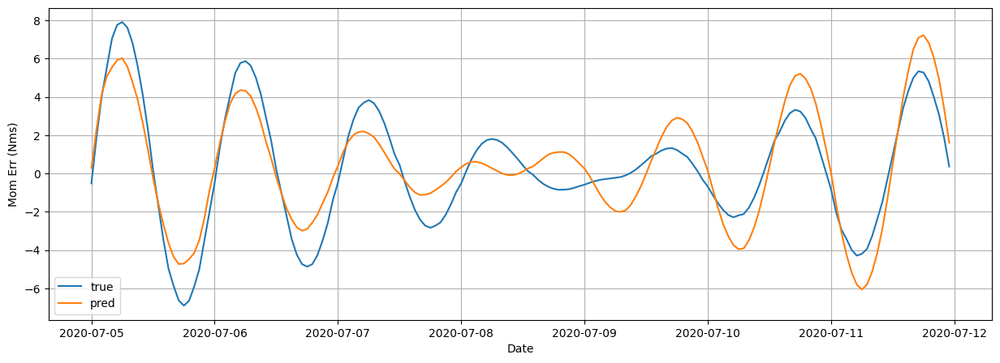

The root mean squared error is 1.359848409947629.
The r2 score is 0.8003401802817801.
168
[1555.96439827]
[1555.96420806]
1/1 [==============================] - 0s 33ms/step
2020-07-04 00:00:00
2020-07-10 23:00:00
The first predicted value is  [0.2605886]
The first actual value is  [-0.5851541]


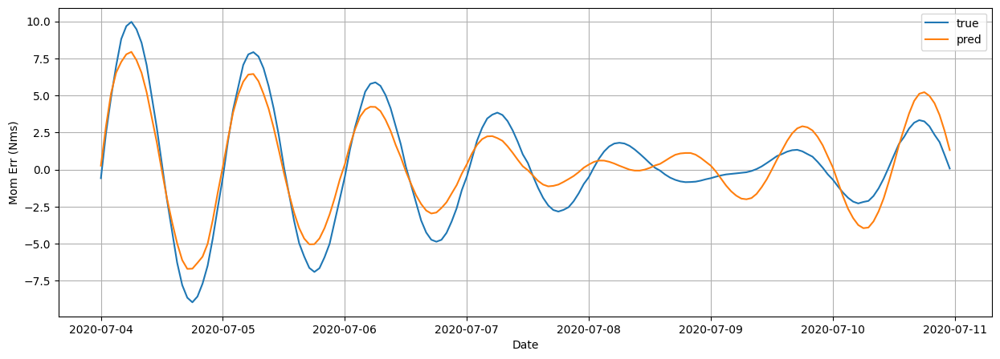

The root mean squared error is 1.3535311714742184.
The r2 score is 0.8689437355885417.
168
[2348.48622015]
[2348.48624431]
1/1 [==============================] - 0s 44ms/step
2020-07-03 00:00:00
2020-07-09 23:00:00
The first predicted value is  [0.25558373]
The first actual value is  [-0.6932932]


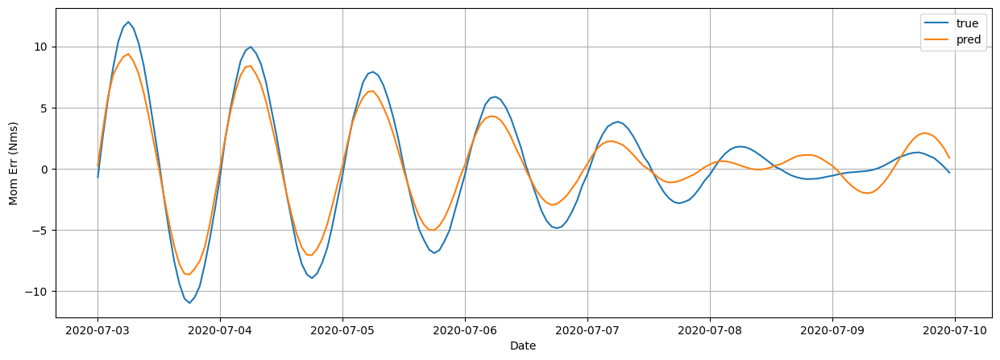

The root mean squared error is 1.383239843669811.
The r2 score is 0.915820039745566.
168
[3818.5242086]
[3818.52418518]
1/1 [==============================] - 0s 39ms/step
2020-06-23 00:00:00
2020-06-29 23:00:00
The first predicted value is  [0.34465367]
The first actual value is  [0.9919131]


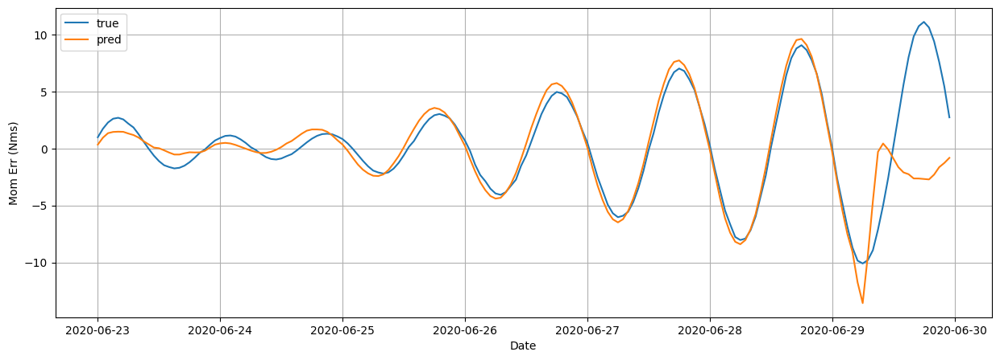

The root mean squared error is 2.843313745853471.
The r2 score is 0.5637740351335829.
168
[3113.48901363]
[3113.48902409]
1/1 [==============================] - 0s 31ms/step
2020-06-22 00:00:00
2020-06-28 23:00:00
The first predicted value is  [0.39415112]
The first actual value is  [1.023209]


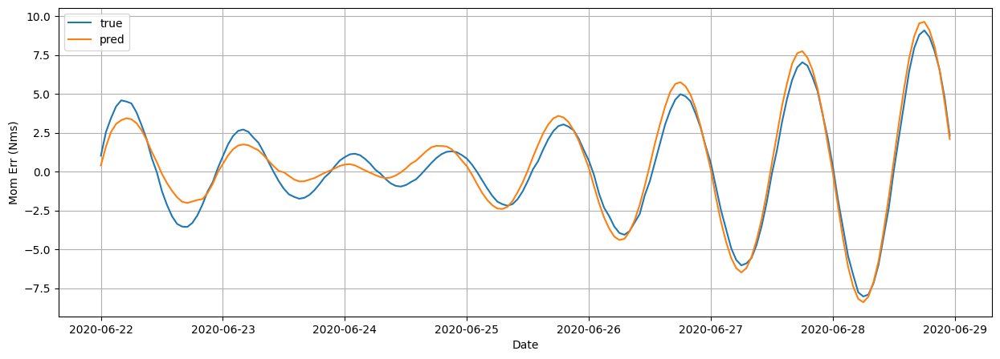

The root mean squared error is 0.7388984125480335.
The r2 score is 0.9534190159461068.
168
[1969.11094463]
[1969.11050778]
1/1 [==============================] - 0s 34ms/step
2020-06-21 00:00:00
2020-06-27 23:00:00
The first predicted value is  [0.40281346]
The first actual value is  [1.013989]


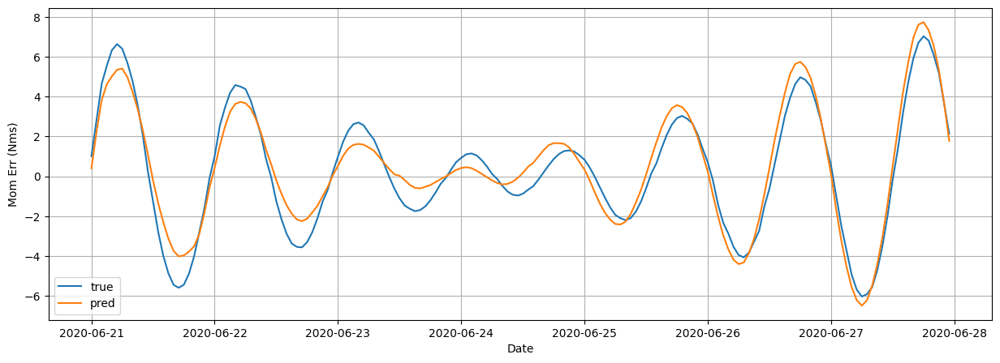

The root mean squared error is 0.7957959336675879.
The r2 score is 0.9308156367423605.
168
[1537.81726266]
[1537.81737984]
1/1 [==============================] - 0s 38ms/step
2020-06-20 00:00:00
2020-06-26 23:00:00
The first predicted value is  [0.3807519]
The first actual value is  [0.9728172]


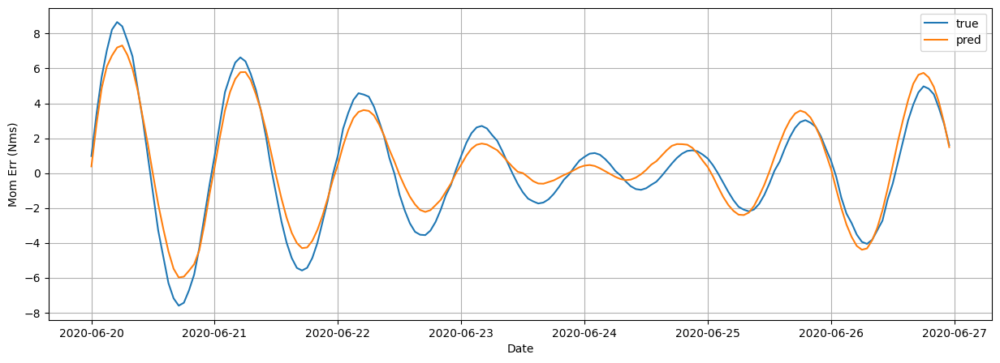

The root mean squared error is 0.8427239914822089.
The r2 score is 0.9342697014299567.
168
[1815.15757762]
[1815.15782726]
1/1 [==============================] - 0s 46ms/step
2020-06-19 00:00:00
2020-06-25 23:00:00
The first predicted value is  [0.38392112]
The first actual value is  [0.8862076]


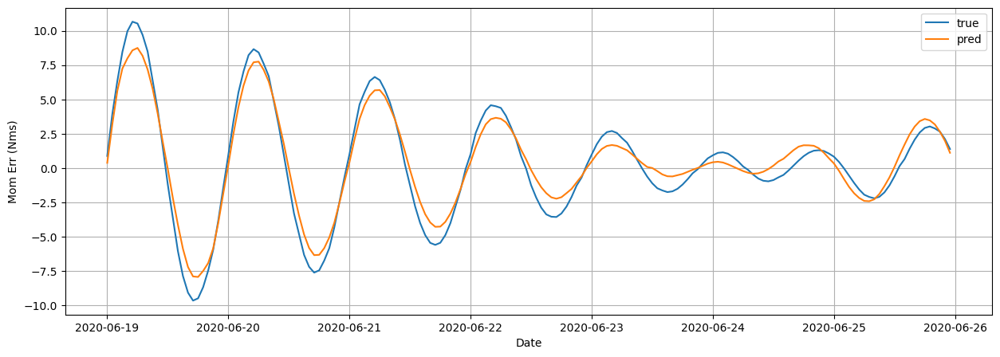

The root mean squared error is 0.9175200194171923.
The r2 score is 0.9497582111231077.
168
[2814.97988987]
[2814.9798169]
1/1 [==============================] - 0s 39ms/step
2020-06-08 00:00:00
2020-06-14 23:00:00
The first predicted value is  [0.48298356]
The first actual value is  [0.7225016]


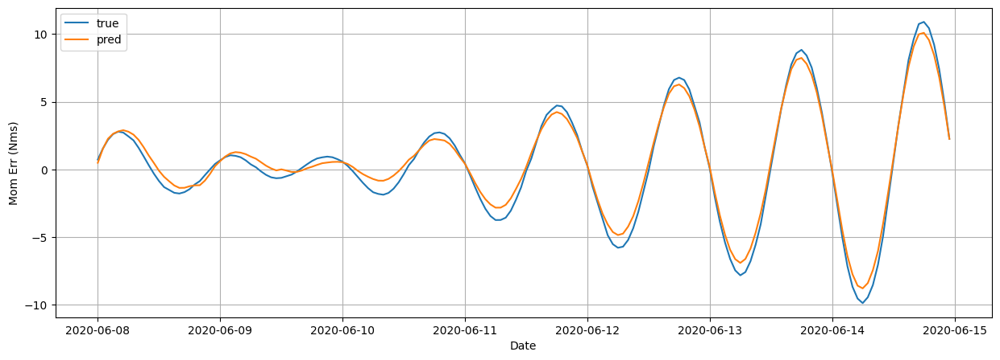

The root mean squared error is 0.566924583665985.
The r2 score is 0.9816066818503343.
168
[2935.6197716]
[2935.61959835]
1/1 [==============================] - 0s 37ms/step
2020-06-07 00:00:00
2020-06-13 23:00:00
The first predicted value is  [0.49868777]
The first actual value is  [0.7410641]


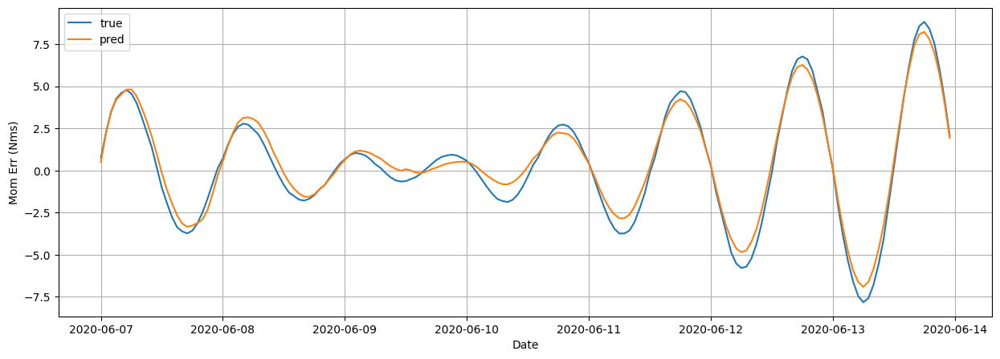

The root mean squared error is 0.5368357012313805.
The r2 score is 0.9738561982284638.
168
[1851.92501284]
[1851.92468191]
1/1 [==============================] - 0s 42ms/step
2020-06-06 00:00:00
2020-06-12 23:00:00
The first predicted value is  [0.483763]
The first actual value is  [0.7344176]


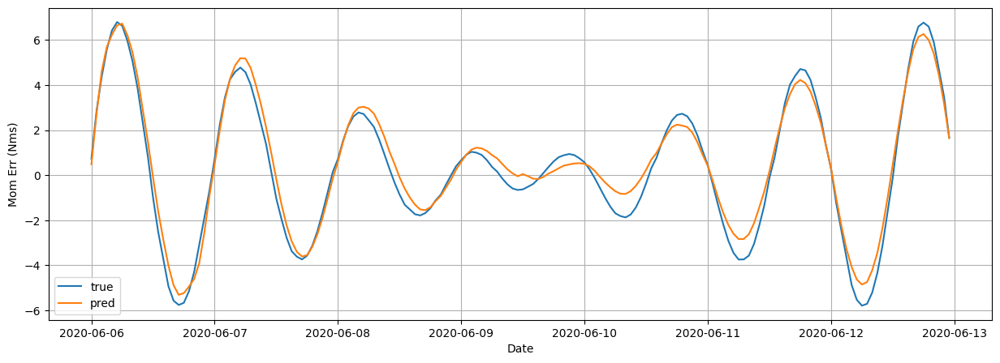

The root mean squared error is 0.5276738505131764.
The r2 score is 0.9688292918434029.
168
[1500.69945301]
[1500.69957049]
1/1 [==============================] - 0s 35ms/step
2020-06-05 00:00:00
2020-06-11 23:00:00
The first predicted value is  [0.49356613]
The first actual value is  [0.6858608]


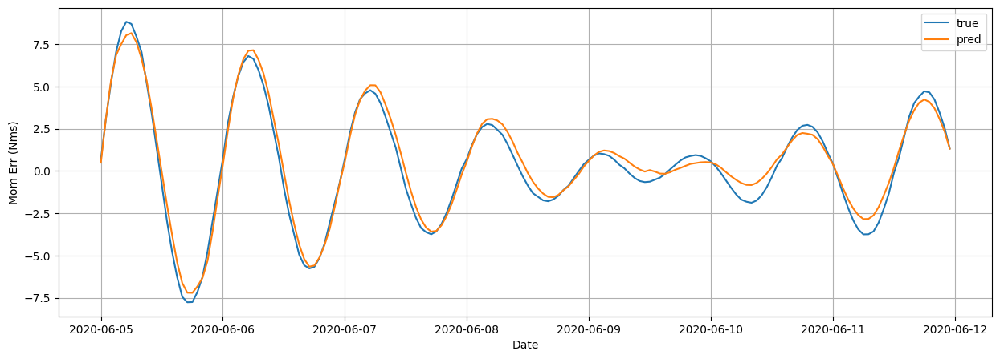

The root mean squared error is 0.5204468395459794.
The r2 score is 0.9755046781817429.
168
[1857.71386079]
[1857.71412545]
1/1 [==============================] - 0s 34ms/step
2020-05-25 00:00:00
2020-05-31 23:00:00
The first predicted value is  [0.56605214]
The first actual value is  [0.7701458]


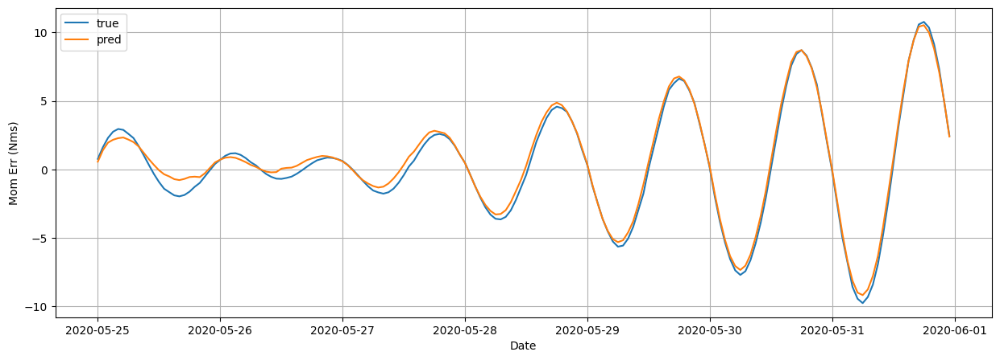

The root mean squared error is 0.43330183190394284.
The r2 score is 0.9888898474192191.
168
[2839.03159689]
[2839.03213713]
1/1 [==============================] - 0s 39ms/step
2020-05-24 00:00:00
2020-05-30 23:00:00
The first predicted value is  [0.58918977]
The first actual value is  [0.7894915]


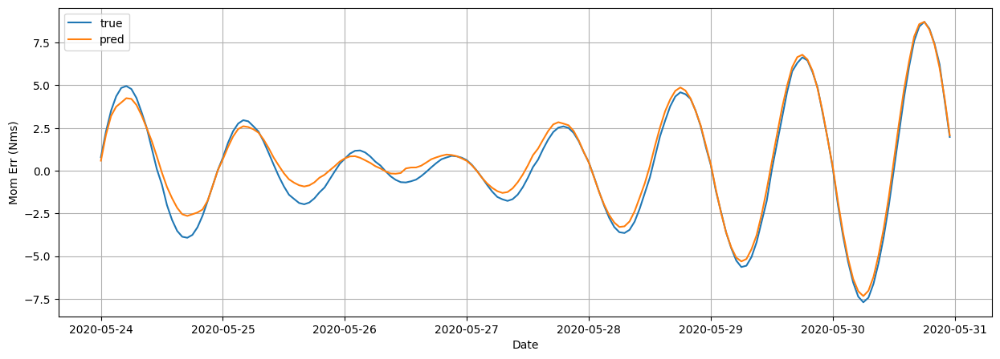

The root mean squared error is 0.4893040363006635.
The r2 score is 0.9778223501712092.
168
[1813.64123373]
[1813.64113062]
1/1 [==============================] - 0s 47ms/step
2020-05-23 00:00:00
2020-05-29 23:00:00
The first predicted value is  [0.581751]
The first actual value is  [0.772776]


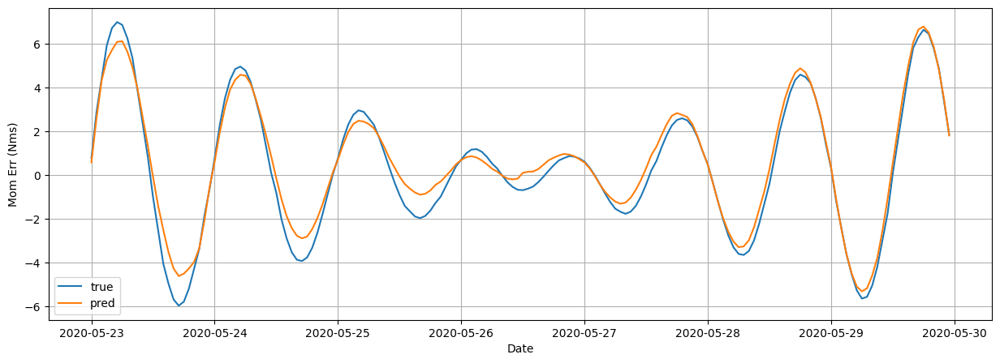

The root mean squared error is 0.552350893813326.
The r2 score is 0.9662030078298047.
168
[1516.56582411]
[1516.56613122]
1/1 [==============================] - 0s 72ms/step
2020-05-05 00:00:00
2020-05-11 23:00:00
The first predicted value is  [0.20699163]
The first actual value is  [0.2532006]


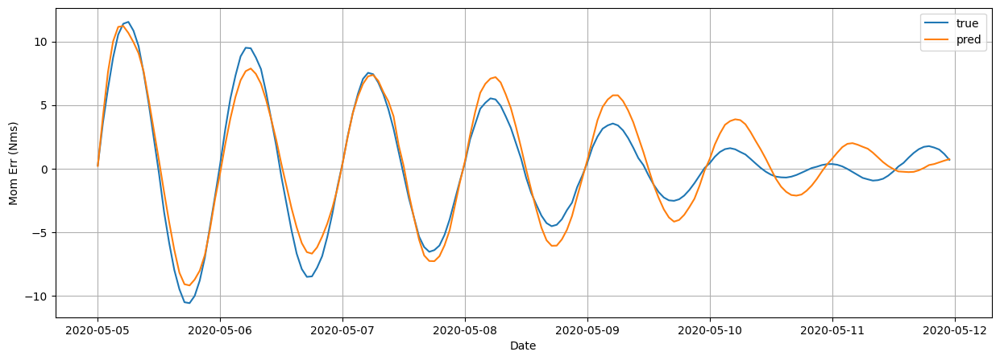

The root mean squared error is 1.2830574099901702.
The r2 score is 0.9206692130864846.
168
[3486.2596209]
[3486.25939653]
1/1 [==============================] - 0s 36ms/step
2020-04-27 00:00:00
2020-05-03 23:00:00
The first predicted value is  [0.67849547]
The first actual value is  [0.3850774]


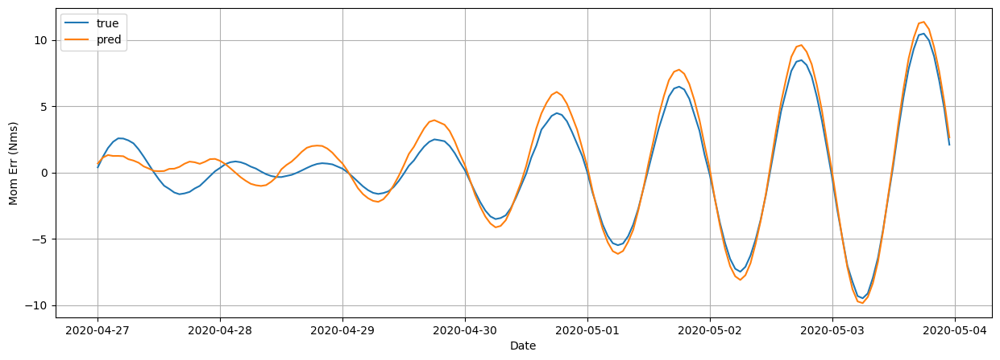

The root mean squared error is 0.9134240037789437.
The r2 score is 0.9476657978279808.
168
[2678.35750991]
[2678.35731084]
1/1 [==============================] - 0s 52ms/step
2020-04-26 00:00:00
2020-05-02 23:00:00
The first predicted value is  [0.7153329]
The first actual value is  [0.3851345]


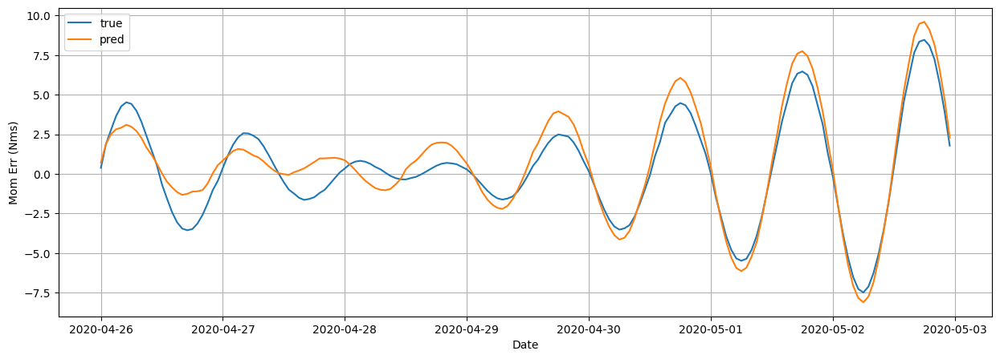

The root mean squared error is 1.020465461266164.
The r2 score is 0.8957118617041273.
168
[1677.53256983]
[1677.5326719]
1/1 [==============================] - 0s 44ms/step
2020-04-25 00:00:00
2020-05-01 23:00:00
The first predicted value is  [0.72191787]
The first actual value is  [0.3612162]


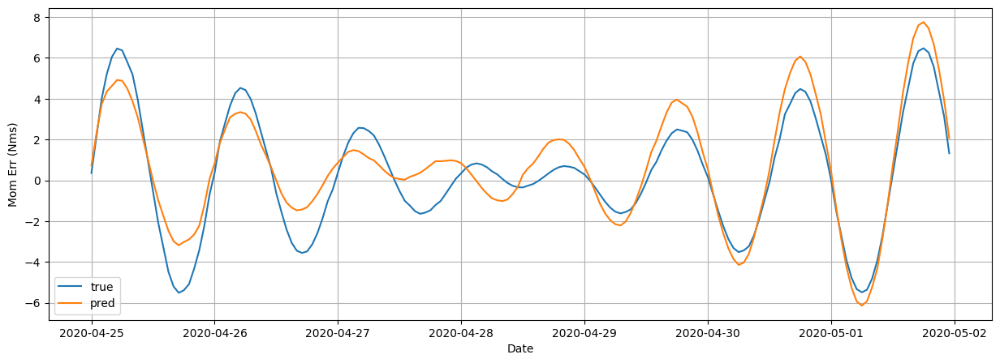

The root mean squared error is 1.1076957410797763.
The r2 score is 0.8471425811361473.
168
[1348.53963393]
[1348.5396858]
1/1 [==============================] - 0s 38ms/step
2020-04-24 00:00:00
2020-04-30 23:00:00
The first predicted value is  [0.75012916]
The first actual value is  [0.2844181]


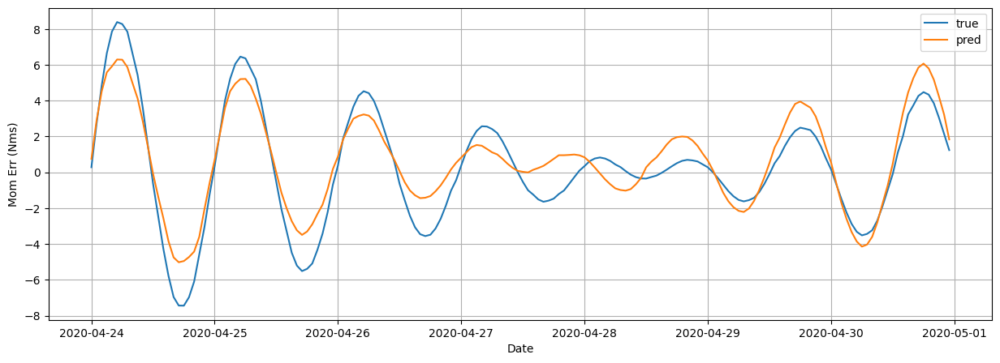

The root mean squared error is 1.2035574097220976.
The r2 score is 0.85484201796494.
168
[1676.49390239]
[1676.4939155]
101


In [ ]:
date_input = []
date_output = []
sk_date = []
start_index_after_nssk = []
date_nosk = []
for index, x in enumerate(start_index):
  timestamp = y_data2.index[x] + pd.Timedelta('14 days')
  timestamp_date = timestamp.date()
  date_input.append(y_data2.index[x])
  date_output.append(timestamp_date)
  if timestamp_date in ewsk_date:
    start_index_after_nssk.append(start_index[index-1])
    sk_date.append(timestamp_date)
  else:
    continue

count = 0
error_matrix = np.zeros((len(start_index), 5)) #chg here also
start_index_iter = iter(start_index)
for y in start_index: #chg here to start_index after nssk? ewsk?
  boo = False
  for z in range(0,168,24):
    ts = y_data2.index[y+z] + pd.Timedelta('14 days')
    ts_date = ts.date()
    if ts_date in nssk_date or ts_date in ewsk_date:
      boo = True #change here to true if you want to try to predict data without any sk
      break

  if boo == True:
    continue
  else:
    ts1 = y_data2.index[y] + pd.Timedelta('14 days')
    ts_date1 = ts1.date()
    date_nosk.append(ts_date1)
    if count<=10:
      print(y)
      ers = plot_comparison(start_idx=y, length=7*24, train=False)
    else:
      ers = plot_comparison(start_idx=y, length=7*24, train=False, plot=True)
    error_matrix[count]=ers
    count = count+1
print(count)
error_matrix = error_matrix[:count]

[0.77592887 0.75969341 0.61406756 1.39878166 0.88784728]
[1.07259873 0.44586409 0.3141977  1.11626865 0.12375925]
[0.01619187 0.12724729 0.10675293 0.22322565 0.33829941]
[8.08443306 2.84331375 1.60075727 7.38719595 0.99763771]


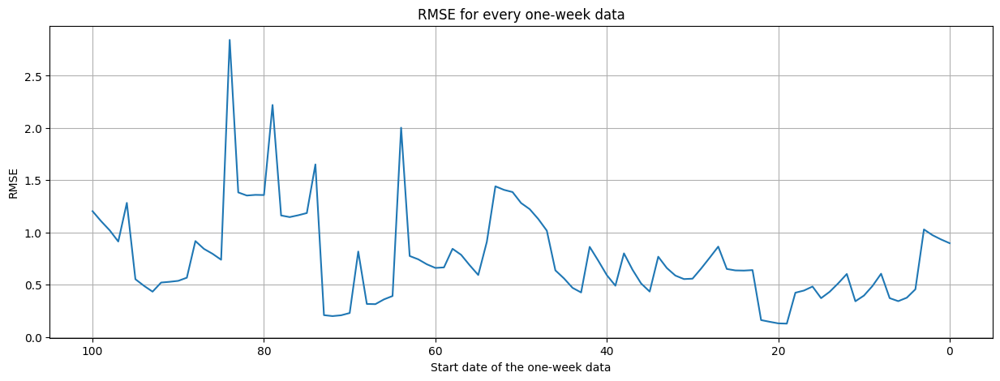

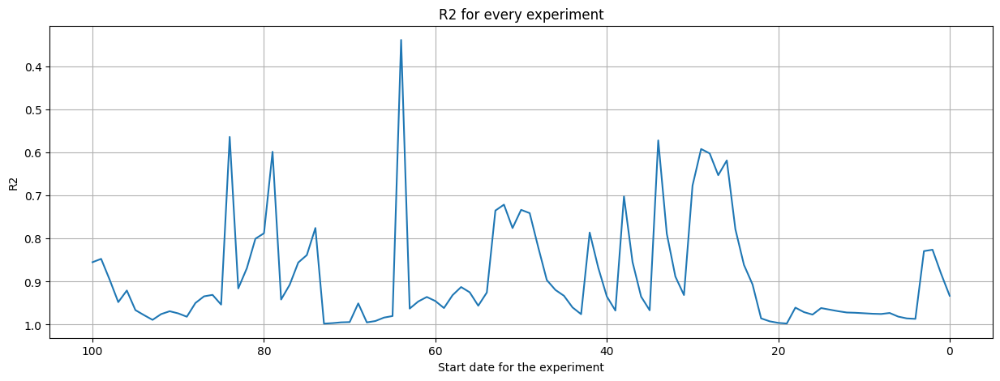

In [ ]:
mean_error_matrix = np.mean(error_matrix, axis=0)
std_error_matrix = np.std(error_matrix, axis=0)
min_error_matrix = np.amin(error_matrix, axis=0)
max_error_matrix = np.amax(error_matrix, axis=0)
print(mean_error_matrix)
print(std_error_matrix)
print(min_error_matrix)
print(max_error_matrix)
# np.set_printoptions(threshold=sys.maxsize)
# print(error_matrix)
plt.figure(figsize=(15,5))
plt.plot(error_matrix[:,1])
plt.title('RMSE for every one-week data')
plt.xlabel('Start date of the one-week data')
plt.ylabel('RMSE')
# date_nosk_str = []
# for e in date_nosk:
#   date_nosk_str.append(str(e))
# print(date_nosk_str)
# xaxis=range(0,101,2)
# plt.xticks(xaxis, rotation='vertical', labels = date_nosk_str[::2])
ax = plt.gca()
ax.invert_xaxis()
plt.grid()
plt.show()

plt.figure(figsize=(15,5))
plt.plot(error_matrix[:,4])
ax = plt.gca()
ax.invert_yaxis()
ax.invert_xaxis()
plt.title('R2 for every experiment')
plt.xlabel('Start date for the experiment')
plt.ylabel('R2')
# plt.xticks(date_nosk, rotation='vertical')
plt.grid()
plt.show()